<a href="https://colab.research.google.com/github/Kostia2004/CovidSegmentation/blob/main/training.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#ох, друг, если ты зашёл сюда, то мне тебя жаль, но я не особо писал этот код и в благородство играть не буду
#а это значит, что не особо верь коментам, я сам не понимаю определённую часть этого

import numpy as np #это замечательная прекрасная библиотека, которая помогает нам нормализовывать наши всратые данные 
import pandas as pd #с помощью этого дерьма мы отобразим один единственный датафрейм и успокоимся
import nibabel as nib #эта штука помогает нам читать все эти всратые врачебные 3д файлы в нечто, понятное нейронке
import matplotlib.pyplot as plt #отрисовываем граааааааааааааааааааааааафики
import cv2 #ещё немного нормализуем
from sklearn.model_selection import train_test_split #ну и надо скрафтить выборки
import tensorflow as tf

In [ ]:
from google.colab import drive
drive.mount('/content/drive') 

Mounted at /content/drive


In [ ]:
!tar -xvf /content/drive/MyDrive/ЭэЭэЭэЭксперименты/Нейронки/MedAI/dataset.tar.gz

Streaming output truncated to the last 5000 lines.
dataset/ct_imgs/coronacases_org_008_100.npy
dataset/ct_imgs/study_0258.ni_3.npy
dataset/ct_imgs/coronacases_org_008_38.npy
dataset/ct_imgs/study_0278.ni_10.npy
dataset/ct_imgs/radiopaedia_org_covid-19-pneumonia-10_85902_3-dcm_390.npy
dataset/ct_imgs/study_0282.ni_34.npy
dataset/ct_imgs/study_0257.ni_20.npy
dataset/ct_imgs/coronacases_org_009_101.npy
dataset/ct_imgs/radiopaedia_org_covid-19-pneumonia-40_86625_0-dcm_22.npy
dataset/ct_imgs/radiopaedia_org_covid-19-pneumonia-36_86526_0-dcm_19.npy
dataset/ct_imgs/coronacases_org_003_183.npy
dataset/ct_imgs/coronacases_org_007_184.npy
dataset/ct_imgs/coronacases_org_001_17.npy
dataset/ct_imgs/radiopaedia_org_covid-19-pneumonia-36_86526_0-dcm_32.npy
dataset/ct_imgs/radiopaedia_org_covid-19-pneumonia-27_86410_0-dcm_29.npy
dataset/ct_imgs/study_0301.ni_15.npy
dataset/ct_imgs/study_0279.ni_37.npy
dataset/ct_imgs/study_0260.ni_10.npy
dataset/ct_imgs/coronacases_org_007_127.npy
dataset/ct_imgs/stu

In [ ]:
metadata = pd.read_csv('/content/dataset/resdf.csv')

In [ ]:
metadata.head()

,Unnamed: 0,ct_img,infect_img
0,0,ct_imgs/coronacases_org_001_0.npy,infection_imgs/coronacases_001_0.npy
1,1,ct_imgs/coronacases_org_001_1.npy,infection_imgs/coronacases_001_1.npy
2,2,ct_imgs/coronacases_org_001_2.npy,infection_imgs/coronacases_001_2.npy
3,3,ct_imgs/coronacases_org_001_3.npy,infection_imgs/coronacases_001_3.npy
4,4,ct_imgs/coronacases_org_001_4.npy,infection_imgs/coronacases_001_4.npy


In [ ]:
from keras.utils.data_utils import Sequence

class InfectDataGen(Sequence):
    #за подробностями в https://medium.com/analytics-vidhya/write-your-own-custom-data-generator-for-tensorflow-keras-1252b64e41c3
    #лучше чем там я не расскажу тем более, что не знаю инглиш
    def __init__(self, df, X_col, y_col,
                 batch_size,
                 shuffle=True):
        
        self.df = df.copy()
        self.X_col = X_col
        self.y_col = y_col
        self.batch_size = batch_size
        self.shuffle = shuffle

        self.n = len(self.df)

        self.lung_model_path = '/content/drive/MyDrive/ЭэЭэЭэЭксперименты/Нейронки/MedAI/lung_unet_model512x512_0222_0217.h5'
        self.lung_model = tf.keras.models.load_model(self.lung_model_path)
    
    def on_epoch_end(self):
        if self.shuffle:
            self.df = self.df.sample(frac=1).reset_index(drop=True)
    
    def __get_input(self, path):
      arr = np.load(path)
      arr = arr[..., np.newaxis]
      return arr
    
    def __get_output(self, path):
      arr = np.load(path)
      #resarr = np.zeros((512, 512, 2))
      #arr = np.expand_dims(arr, 2)
      #resarr[:,:,0] = arr==1
      #resarr[:,:,1] = arr==0
      arr[arr>0]=1
      resarr = arr[..., np.newaxis]
      return resarr
    
    def __get_data(self, batches):
      # Generates data containing batch_size samples
      ct_path_batch = batches[self.X_col['ct_path']]
      infect_path_batch = batches[self.y_col['infect_path']]
      X_batch = np.asarray([self.__get_input('/content/dataset/'+x) for x in ct_path_batch])
      y_batch = np.asarray([self.__get_output('/content/dataset/'+y) for y in infect_path_batch])
      return X_batch, y_batch
    
    def __getitem__(self, index):
      '''Роль метода __getitem__ заключается в генерации одного батча данных. 
      В данном случае одной партией данных будет пара значений (X, y), где X представляет вход, а y - выход.'''
        
      batches = self.df[index * self.batch_size:(index + 1) * self.batch_size]
      X, y = self.__get_data(batches) 
      X = np.array(X)/255.
      X[self.lung_model.predict(X)<=0.01] = 0
      return X, y
    
    def __len__(self):
        return self.n // self.batch_size

In [ ]:
VAL_SPLIT = 0.8

In [ ]:
resdf = metadata.sample(frac=1)

traingen = InfectDataGen(resdf.iloc[:int((resdf.shape[0]-1)*VAL_SPLIT), :],
                         X_col={'ct_path':'ct_img'},
                         y_col={'infect_path': 'infect_img'},
                         batch_size=8)

valgen = InfectDataGen(resdf.iloc[int((resdf.shape[0]-1)*VAL_SPLIT):, :],
                        X_col={'ct_path':'ct_img'},
                        y_col={'infect_path': 'infect_img'},
                        batch_size=8)

type(traingen), type(valgen)

(__main__.InfectDataGen, __main__.InfectDataGen)

In [ ]:
img_size = 512

#U-Net

In [ ]:
from keras.models import *
from keras.layers import *
from keras.optimizers import *
from keras import metrics

def build_unet_model(input_layer):    
    c1 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (input_layer)
    c1 = Dropout(0.1) (c1)
    c1 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c1)
    p1 = MaxPooling2D((2, 2)) (c1)

    c2 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p1)
    c2 = Dropout(0.1) (c2)
    c2 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c2)
    p2 = MaxPooling2D((2, 2)) (c2)

    c3 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p2)
    c3 = Dropout(0.2) (c3)
    c3 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c3)
    p3 = MaxPooling2D((2, 2)) (c3)

    c4 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p3)
    c4 = Dropout(0.2) (c4)
    c4 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c4)
    p4 = MaxPooling2D(pool_size=(2, 2)) (c4)

    c5 = Conv2D(256, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p4)
    c5 = Dropout(0.3) (c5)
    c5 = Conv2D(256, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c5)

    u6 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same') (c5)
    u6 = concatenate([u6, c4])
    c6 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u6)
    c6 = Dropout(0.2) (c6)
    c6 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c6)

    u7 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same') (c6)
    u7 = concatenate([u7, c3])
    c7 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u7)
    c7 = Dropout(0.2) (c7)
    c7 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c7)

    u8 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same') (c7)
    u8 = concatenate([u8, c2])
    c8 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u8)
    c8 = Dropout(0.1) (c8)
    c8 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c8)

    u9 = Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same') (c8)
    u9 = concatenate([u9, c1], axis=3)
    c9 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u9)
    c9 = Dropout(0.1) (c9)
    c9 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c9)

    output_layer = Conv2D(1, (1, 1), activation='sigmoid') (c9)
    
    return output_layer

In [ ]:
from IPython import display

def fitUnetModel(epochs, metrics):
  input_layer = Input((img_size, img_size, 1))
  output_layer = build_unet_model(input_layer)
  model = Model(input_layer, output_layer)
  slicenum = 10
  model.compile(loss="binary_crossentropy", optimizer="adam", metrics=metrics)
  hist = {}
  for i in range(epochs//2):
    print(i)
    history = model.fit_generator(generator=traingen, epochs=2, validation_data=valgen, validation_freq=1)
    if len(hist.keys())==0:
      hist = history.history
    else:
      for key in history.history.keys():
        hist[key].extend(history.history[key])
    print(hist)
    for metr in hist.keys():
      fig = plt.figure()
      if not metr.startswith('val_'):
        print(metr)
        plt.plot(hist[metr], color='blue')
        plt.plot(hist['val_'+metr], color='orange')
        plt.title(metr.capitalize()+' vs Epochs')
        plt.xlabel('Epochs')
        plt.ylabel(metr.capitalize())
        plt.legend(['Train', 'Val'], loc = 'upper left')
        display.display(plt.gcf())
      del fig
    print(valgen[slicenum][0].shape)
    lung_slice = valgen[slicenum][0][0]
    infect_slice = valgen[slicenum][1][0]
    predicted = model.predict(valgen[slicenum][0])
    fig = plt.figure(figsize = (18,15))

    plt.subplot(1,3,1)
    #plt.imshow(lung_test[slicenum][...,0], cmap = 'bone')
    plt.imshow(lung_slice[...,0], cmap = 'bone')
    plt.title('original lung')

    plt.subplot(1,3,2)
    plt.imshow(lung_slice[...,0], cmap = 'bone')
    plt.imshow(infect_slice[...,0],alpha = 0.5, cmap = "nipy_spectral")
    plt.title('original infection mask')

    plt.subplot(1,3,3)
    plt.imshow(lung_slice[...,0], cmap = 'bone')
    plt.imshow(predicted[0,:,:,0],alpha = 0.5,cmap = "nipy_spectral")
    plt.title('predicted infection mask')
    display.display(plt.gcf())
    del fig
    model.save('unet_model512x512.h5')
  return model

0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  if sys.path[0] == '':


Epoch 1/2
556/556 [==============================] - 275s 487ms/step - loss: 0.0274 - auc: 0.9310 - val_loss: 0.0237 - val_auc: 0.9401
Epoch 2/2
556/556 [==============================] - 281s 506ms/step - loss: 0.0218 - auc: 0.9558 - val_loss: 0.0207 - val_auc: 0.9654
{'loss': [0.027390234172344208, 0.02176962047815323], 'auc': [0.931035578250885, 0.9558085203170776], 'val_loss': [0.023687470704317093, 0.020748628303408623], 'val_auc': [0.9400752782821655, 0.9653528928756714]}
loss


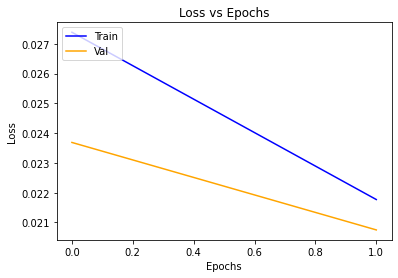

auc


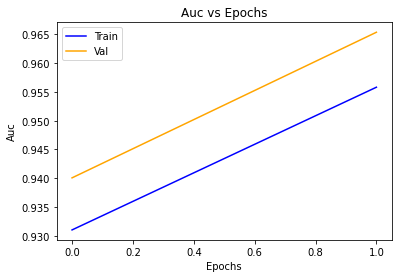

(8, 512, 512, 1)


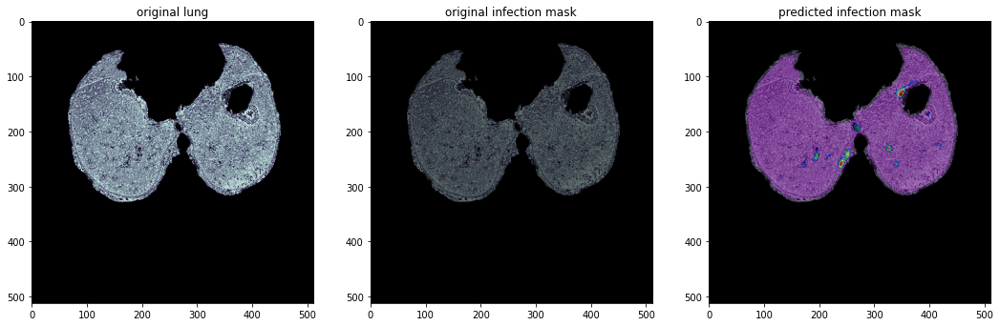

1
Epoch 1/2
556/556 [==============================] - 280s 504ms/step - loss: 0.0202 - auc: 0.9650 - val_loss: 0.0192 - val_auc: 0.9728
Epoch 2/2
556/556 [==============================] - 282s 508ms/step - loss: 0.0196 - auc: 0.9660 - val_loss: 0.0219 - val_auc: 0.9572
{'loss': [0.027390234172344208, 0.02176962047815323, 0.020211687311530113, 0.019601361826062202], 'auc': [0.931035578250885, 0.9558085203170776, 0.9650401473045349, 0.9660261869430542], 'val_loss': [0.023687470704317093, 0.020748628303408623, 0.019231636077165604, 0.02192317135632038], 'val_auc': [0.9400752782821655, 0.9653528928756714, 0.972781240940094, 0.9571613669395447]}
loss


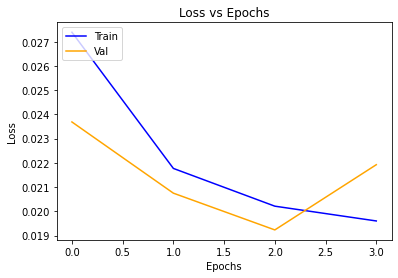

auc


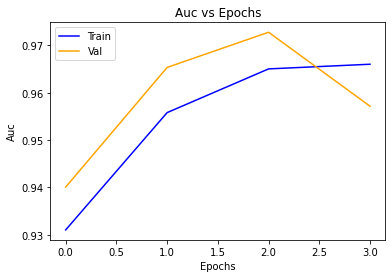

(8, 512, 512, 1)


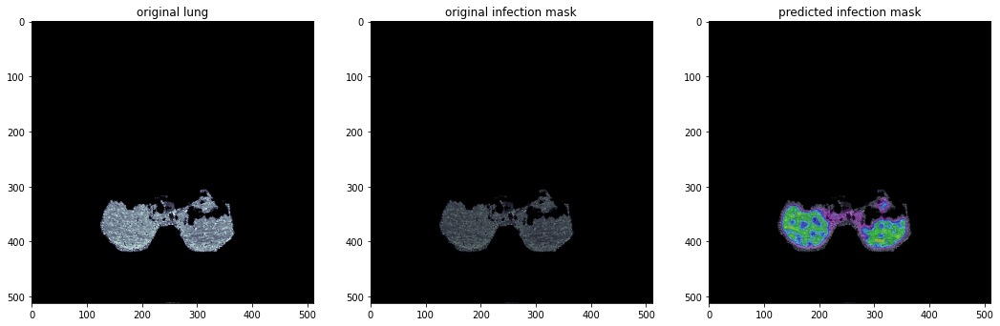

2
Epoch 1/2
556/556 [==============================] - 279s 502ms/step - loss: 0.0180 - auc: 0.9706 - val_loss: 0.0164 - val_auc: 0.9755
Epoch 2/2
556/556 [==============================] - 279s 503ms/step - loss: 0.0160 - auc: 0.9736 - val_loss: 0.0171 - val_auc: 0.9544
{'loss': [0.027390234172344208, 0.02176962047815323, 0.020211687311530113, 0.019601361826062202, 0.01802997849881649, 0.015969663858413696], 'auc': [0.931035578250885, 0.9558085203170776, 0.9650401473045349, 0.9660261869430542, 0.970612108707428, 0.9736357927322388], 'val_loss': [0.023687470704317093, 0.020748628303408623, 0.019231636077165604, 0.02192317135632038, 0.01637619361281395, 0.01708078198134899], 'val_auc': [0.9400752782821655, 0.9653528928756714, 0.972781240940094, 0.9571613669395447, 0.9754557609558105, 0.954389214515686]}
loss


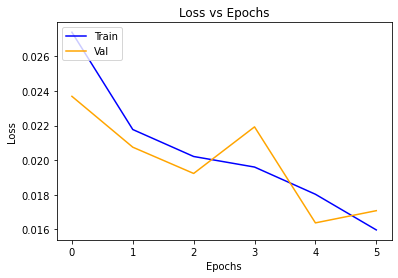

auc


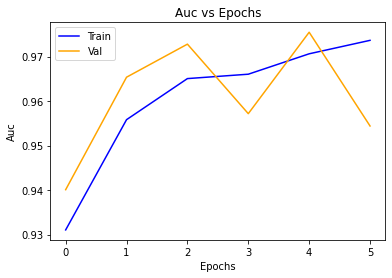

(8, 512, 512, 1)


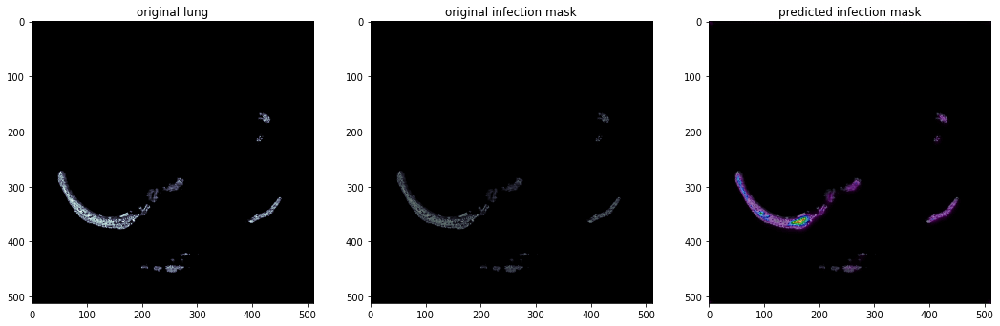

3
Epoch 1/2
556/556 [==============================] - 283s 508ms/step - loss: 0.0151 - auc: 0.9745 - val_loss: 0.0143 - val_auc: 0.9720
Epoch 2/2
556/556 [==============================] - 282s 507ms/step - loss: 0.0133 - auc: 0.9776 - val_loss: 0.0131 - val_auc: 0.9544
{'loss': [0.027390234172344208, 0.02176962047815323, 0.020211687311530113, 0.019601361826062202, 0.01802997849881649, 0.015969663858413696, 0.015121761709451675, 0.013308562338352203], 'auc': [0.931035578250885, 0.9558085203170776, 0.9650401473045349, 0.9660261869430542, 0.970612108707428, 0.9736357927322388, 0.9745272994041443, 0.9775508046150208], 'val_loss': [0.023687470704317093, 0.020748628303408623, 0.019231636077165604, 0.02192317135632038, 0.01637619361281395, 0.01708078198134899, 0.014285757206380367, 0.01314636506140232], 'val_auc': [0.9400752782821655, 0.9653528928756714, 0.972781240940094, 0.9571613669395447, 0.9754557609558105, 0.954389214515686, 0.9720141887664795, 0.9543718099594116]}
loss


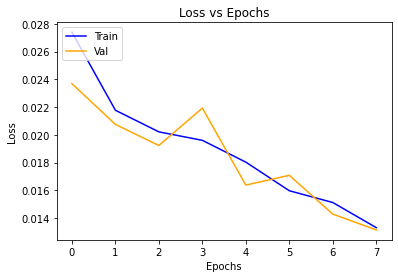

auc


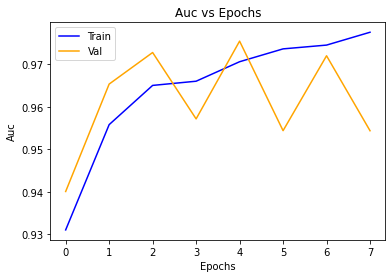

(8, 512, 512, 1)


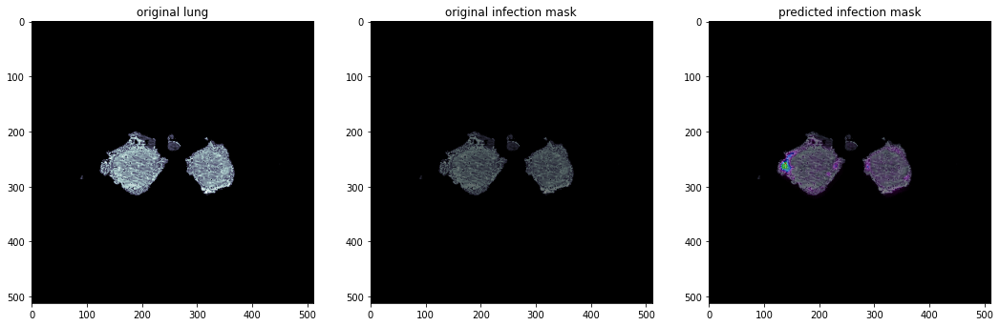

4
Epoch 1/2
556/556 [==============================] - 283s 509ms/step - loss: 0.0126 - auc: 0.9791 - val_loss: 0.0114 - val_auc: 0.9816
Epoch 2/2
556/556 [==============================] - 283s 510ms/step - loss: 0.0118 - auc: 0.9809 - val_loss: 0.0119 - val_auc: 0.9832
{'loss': [0.027390234172344208, 0.02176962047815323, 0.020211687311530113, 0.019601361826062202, 0.01802997849881649, 0.015969663858413696, 0.015121761709451675, 0.013308562338352203, 0.01259167306125164, 0.011823250912129879], 'auc': [0.931035578250885, 0.9558085203170776, 0.9650401473045349, 0.9660261869430542, 0.970612108707428, 0.9736357927322388, 0.9745272994041443, 0.9775508046150208, 0.979147732257843, 0.9809139370918274], 'val_loss': [0.023687470704317093, 0.020748628303408623, 0.019231636077165604, 0.02192317135632038, 0.01637619361281395, 0.01708078198134899, 0.014285757206380367, 0.01314636506140232, 0.011414325796067715, 0.011906517669558525], 'val_auc': [0.9400752782821655, 0.9653528928756714, 0.9727812409

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


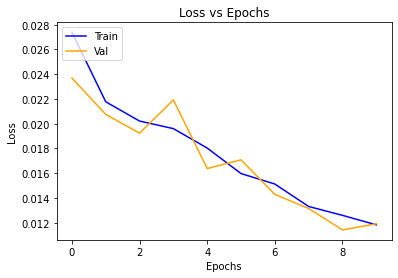

auc


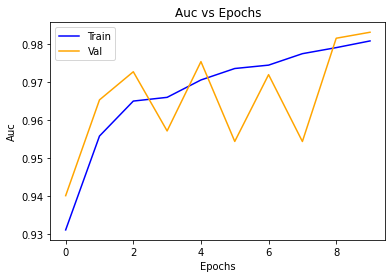

(8, 512, 512, 1)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


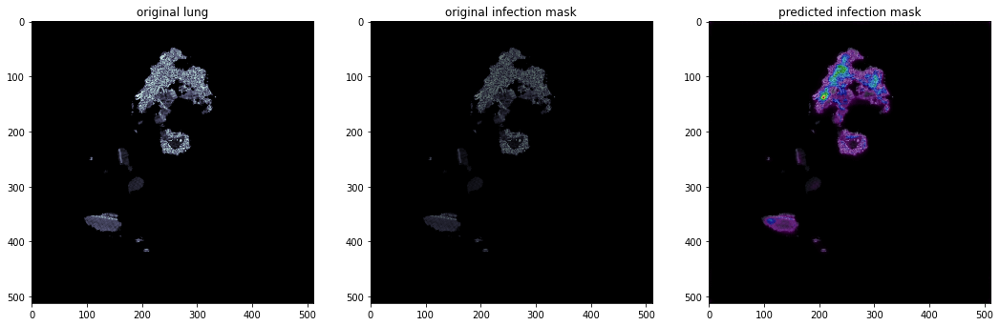

5
Epoch 1/2
556/556 [==============================] - 283s 509ms/step - loss: 0.0111 - auc: 0.9832 - val_loss: 0.0104 - val_auc: 0.9858
Epoch 2/2
556/556 [==============================] - 283s 509ms/step - loss: 0.0107 - auc: 0.9842 - val_loss: 0.0108 - val_auc: 0.9823
{'loss': [0.027390234172344208, 0.02176962047815323, 0.020211687311530113, 0.019601361826062202, 0.01802997849881649, 0.015969663858413696, 0.015121761709451675, 0.013308562338352203, 0.01259167306125164, 0.011823250912129879, 0.011054583825170994, 0.010695460252463818], 'auc': [0.931035578250885, 0.9558085203170776, 0.9650401473045349, 0.9660261869430542, 0.970612108707428, 0.9736357927322388, 0.9745272994041443, 0.9775508046150208, 0.979147732257843, 0.9809139370918274, 0.9832119345664978, 0.984200119972229], 'val_loss': [0.023687470704317093, 0.020748628303408623, 0.019231636077165604, 0.02192317135632038, 0.01637619361281395, 0.01708078198134899, 0.014285757206380367, 0.01314636506140232, 0.011414325796067715, 0.01

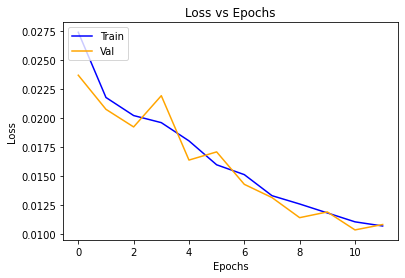

auc


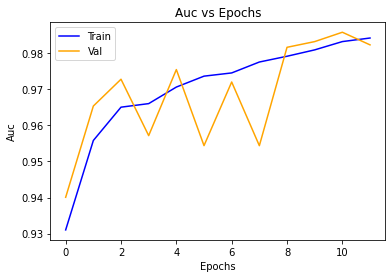

(8, 512, 512, 1)


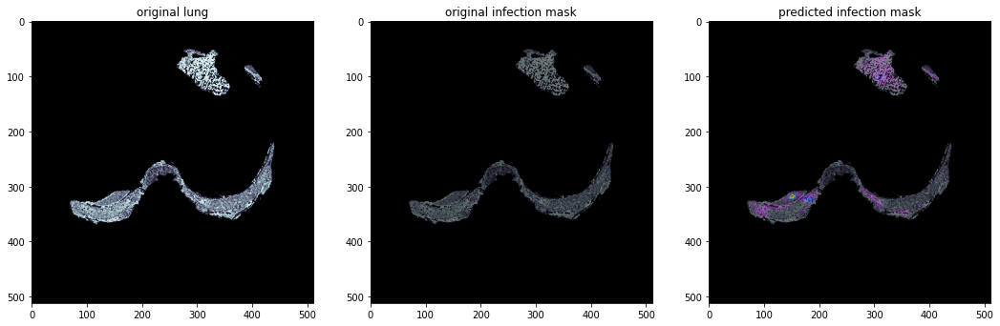

6
Epoch 1/2
556/556 [==============================] - 279s 503ms/step - loss: 0.0102 - auc: 0.9850 - val_loss: 0.0098 - val_auc: 0.9875
Epoch 2/2
556/556 [==============================] - 282s 507ms/step - loss: 0.0094 - auc: 0.9869 - val_loss: 0.0094 - val_auc: 0.9837
{'loss': [0.027390234172344208, 0.02176962047815323, 0.020211687311530113, 0.019601361826062202, 0.01802997849881649, 0.015969663858413696, 0.015121761709451675, 0.013308562338352203, 0.01259167306125164, 0.011823250912129879, 0.011054583825170994, 0.010695460252463818, 0.010160015895962715, 0.009449378587305546], 'auc': [0.931035578250885, 0.9558085203170776, 0.9650401473045349, 0.9660261869430542, 0.970612108707428, 0.9736357927322388, 0.9745272994041443, 0.9775508046150208, 0.979147732257843, 0.9809139370918274, 0.9832119345664978, 0.984200119972229, 0.9850457310676575, 0.9868671298027039], 'val_loss': [0.023687470704317093, 0.020748628303408623, 0.019231636077165604, 0.02192317135632038, 0.01637619361281395, 0.0170

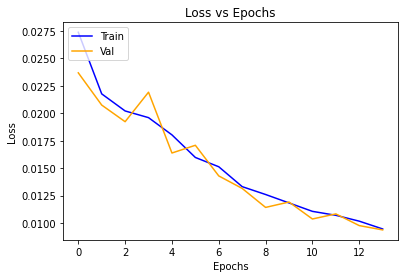

auc


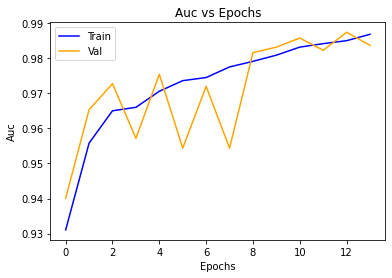

(8, 512, 512, 1)


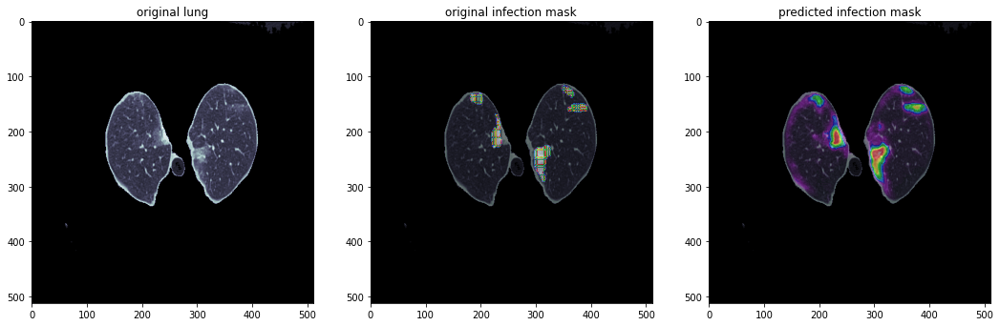

7
Epoch 1/2
556/556 [==============================] - 279s 503ms/step - loss: 0.0092 - auc: 0.9870 - val_loss: 0.0095 - val_auc: 0.9916
Epoch 2/2
556/556 [==============================] - 283s 509ms/step - loss: 0.0087 - auc: 0.9876 - val_loss: 0.0089 - val_auc: 0.9931
{'loss': [0.027390234172344208, 0.02176962047815323, 0.020211687311530113, 0.019601361826062202, 0.01802997849881649, 0.015969663858413696, 0.015121761709451675, 0.013308562338352203, 0.01259167306125164, 0.011823250912129879, 0.011054583825170994, 0.010695460252463818, 0.010160015895962715, 0.009449378587305546, 0.009248682297766209, 0.008739997632801533], 'auc': [0.931035578250885, 0.9558085203170776, 0.9650401473045349, 0.9660261869430542, 0.970612108707428, 0.9736357927322388, 0.9745272994041443, 0.9775508046150208, 0.979147732257843, 0.9809139370918274, 0.9832119345664978, 0.984200119972229, 0.9850457310676575, 0.9868671298027039, 0.9870095252990723, 0.9875977039337158], 'val_loss': [0.023687470704317093, 0.020748

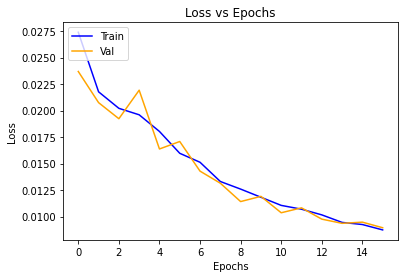

auc


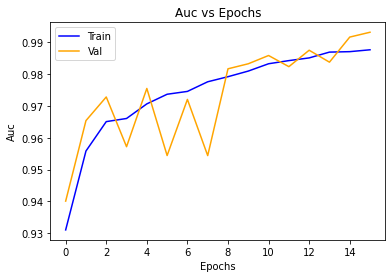

(8, 512, 512, 1)


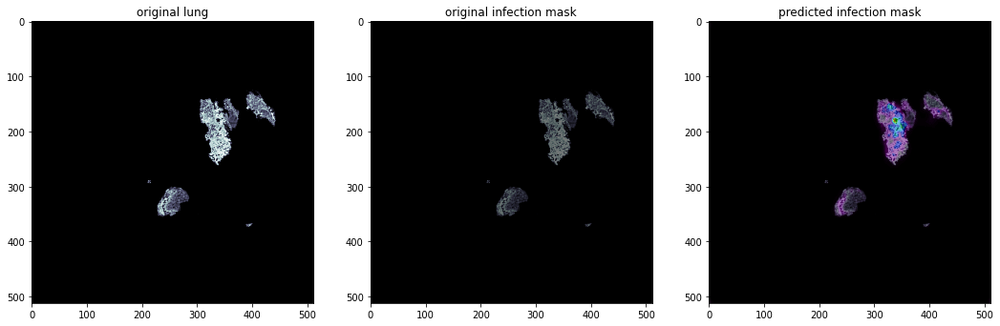

8
Epoch 1/2
556/556 [==============================] - 283s 509ms/step - loss: 0.0083 - auc: 0.9885 - val_loss: 0.0085 - val_auc: 0.9868
Epoch 2/2
556/556 [==============================] - 285s 512ms/step - loss: 0.0080 - auc: 0.9896 - val_loss: 0.0080 - val_auc: 0.9895
{'loss': [0.027390234172344208, 0.02176962047815323, 0.020211687311530113, 0.019601361826062202, 0.01802997849881649, 0.015969663858413696, 0.015121761709451675, 0.013308562338352203, 0.01259167306125164, 0.011823250912129879, 0.011054583825170994, 0.010695460252463818, 0.010160015895962715, 0.009449378587305546, 0.009248682297766209, 0.008739997632801533, 0.00827216450124979, 0.007971830666065216], 'auc': [0.931035578250885, 0.9558085203170776, 0.9650401473045349, 0.9660261869430542, 0.970612108707428, 0.9736357927322388, 0.9745272994041443, 0.9775508046150208, 0.979147732257843, 0.9809139370918274, 0.9832119345664978, 0.984200119972229, 0.9850457310676575, 0.9868671298027039, 0.9870095252990723, 0.9875977039337158, 0

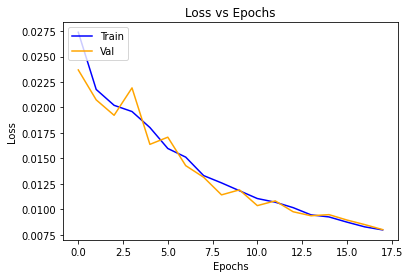

auc


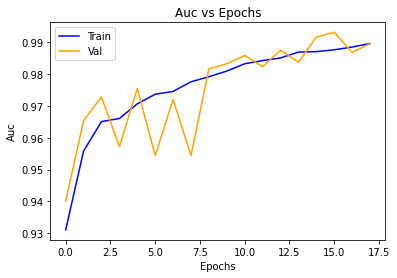

(8, 512, 512, 1)


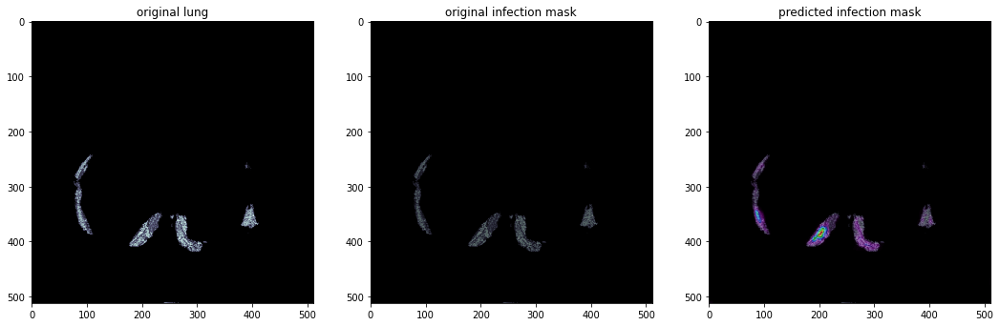

9
Epoch 1/2
556/556 [==============================] - 281s 506ms/step - loss: 0.0077 - auc: 0.9899 - val_loss: 0.0081 - val_auc: 0.9872
Epoch 2/2
556/556 [==============================] - 283s 510ms/step - loss: 0.0076 - auc: 0.9901 - val_loss: 0.0080 - val_auc: 0.9842
{'loss': [0.027390234172344208, 0.02176962047815323, 0.020211687311530113, 0.019601361826062202, 0.01802997849881649, 0.015969663858413696, 0.015121761709451675, 0.013308562338352203, 0.01259167306125164, 0.011823250912129879, 0.011054583825170994, 0.010695460252463818, 0.010160015895962715, 0.009449378587305546, 0.009248682297766209, 0.008739997632801533, 0.00827216450124979, 0.007971830666065216, 0.007689409889280796, 0.007618164177983999], 'auc': [0.931035578250885, 0.9558085203170776, 0.9650401473045349, 0.9660261869430542, 0.970612108707428, 0.9736357927322388, 0.9745272994041443, 0.9775508046150208, 0.979147732257843, 0.9809139370918274, 0.9832119345664978, 0.984200119972229, 0.9850457310676575, 0.986867129802703

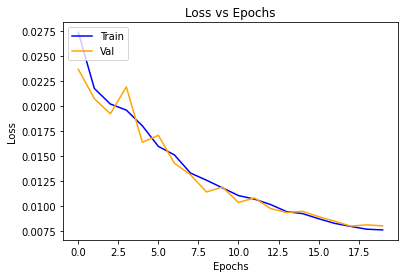

auc


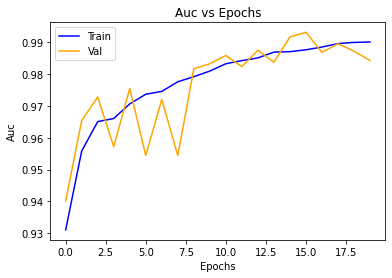

(8, 512, 512, 1)


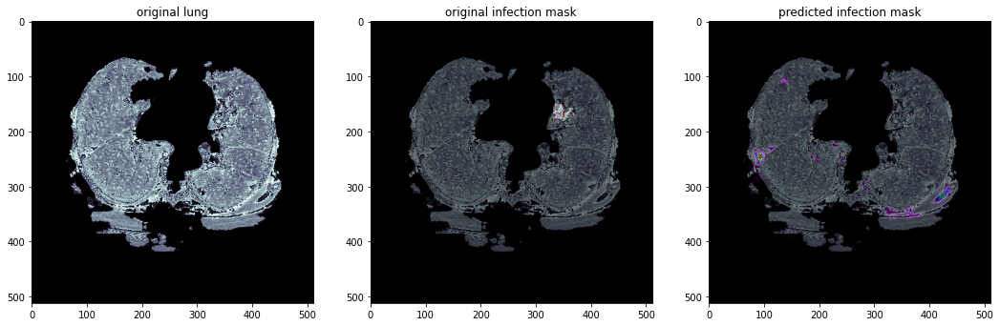

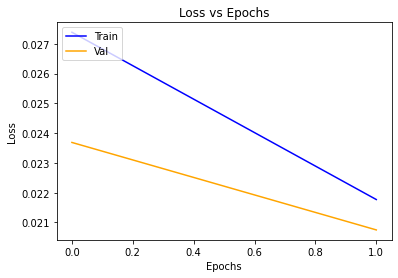

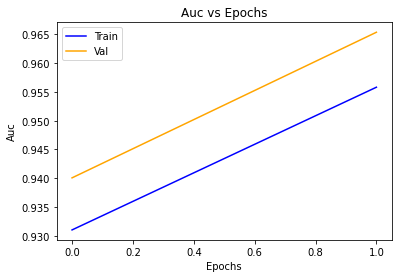

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

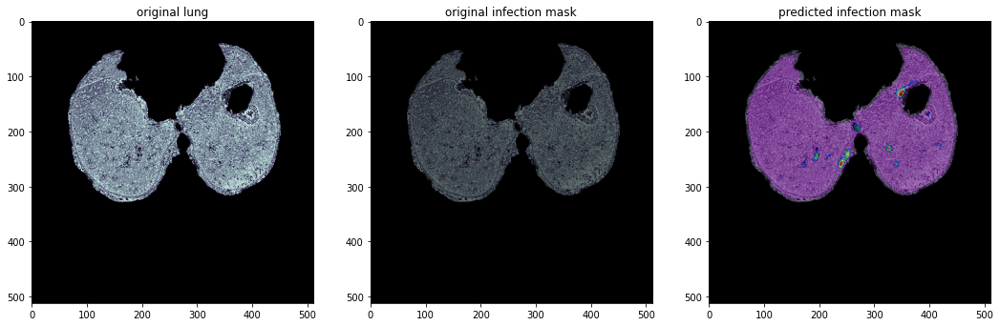

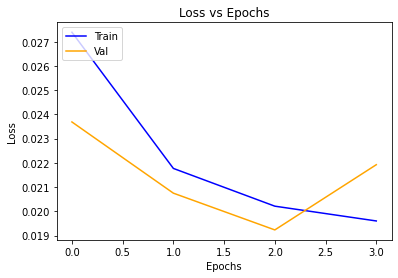

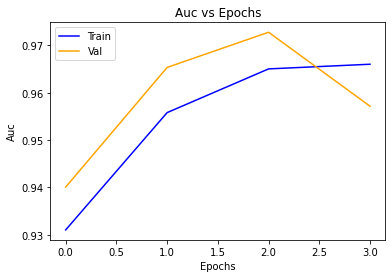

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

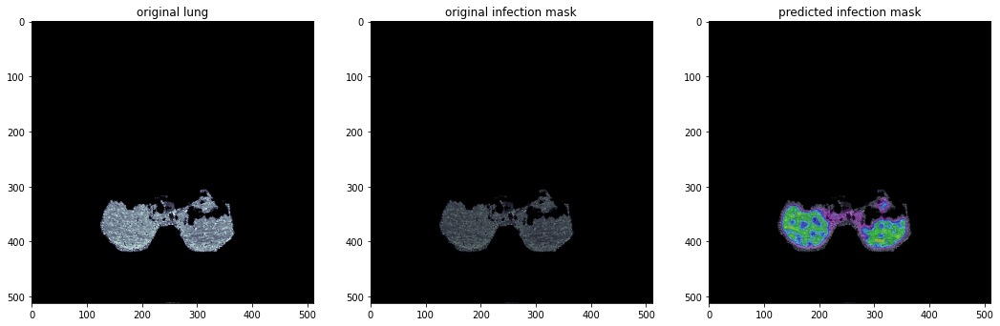

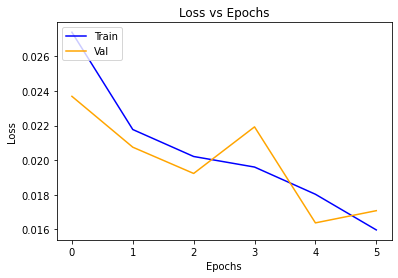

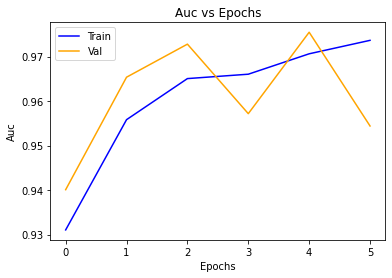

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

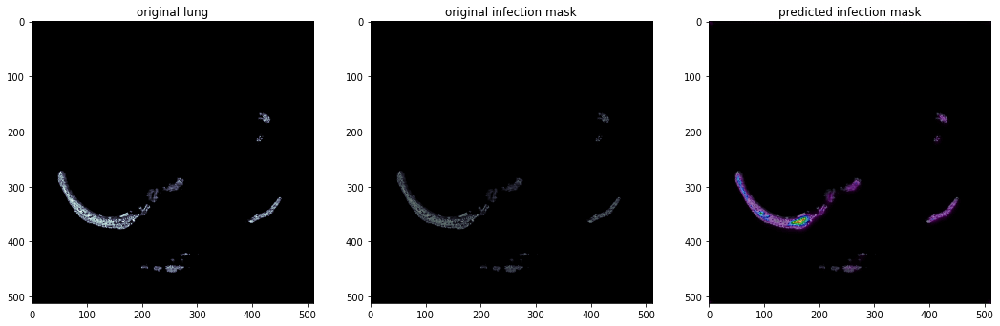

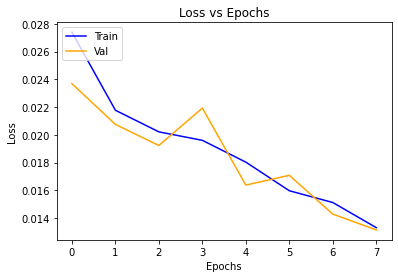

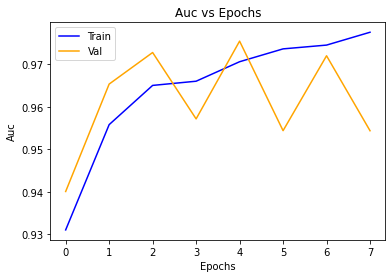

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

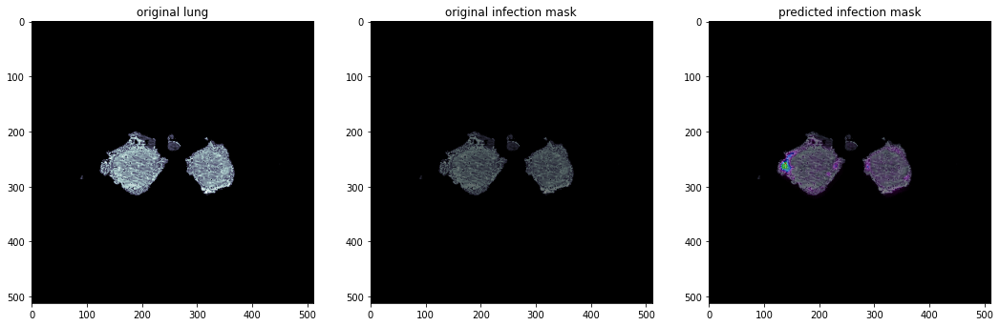

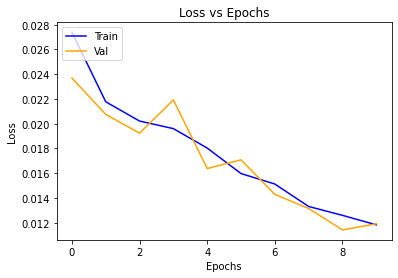

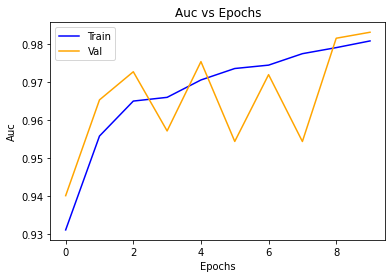

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

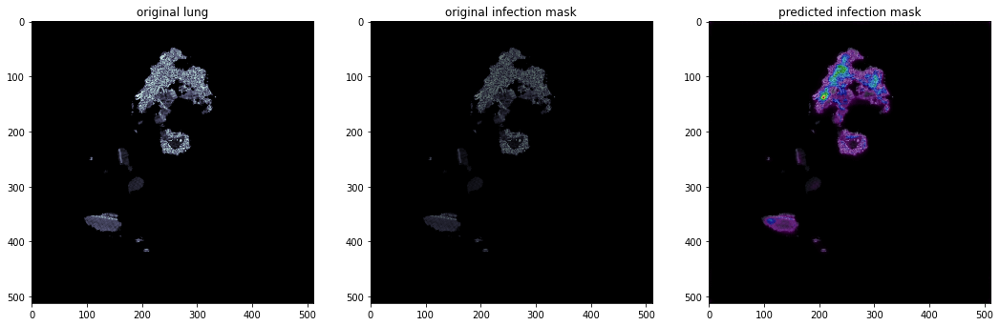

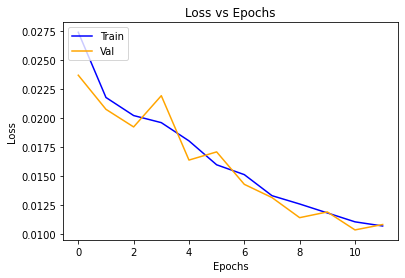

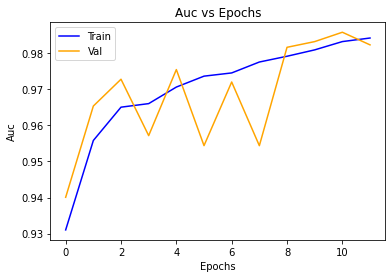

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

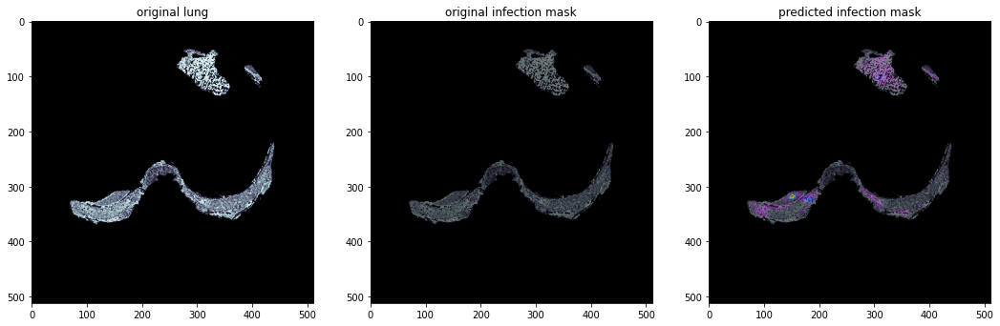

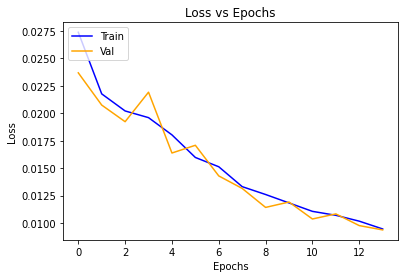

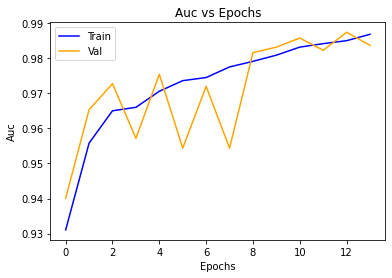

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

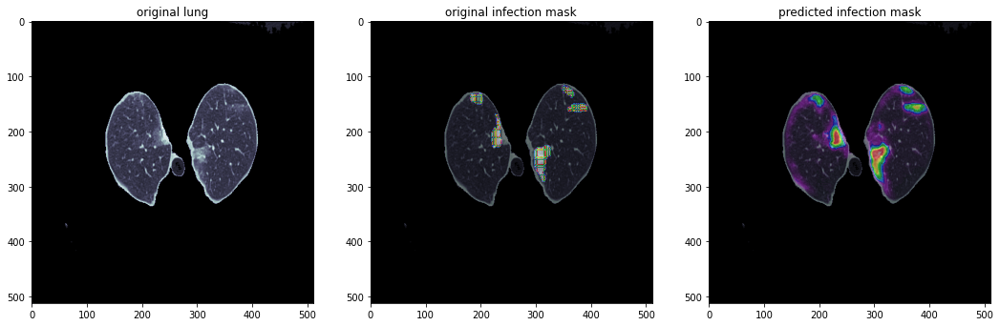

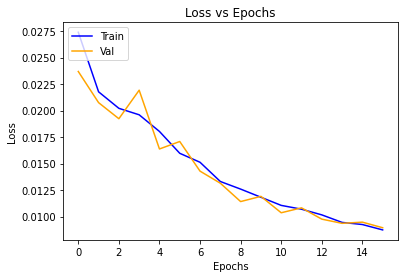

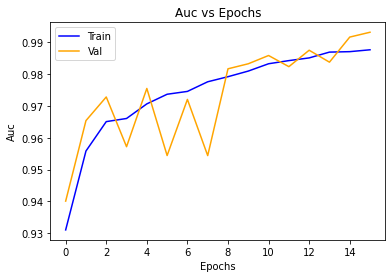

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

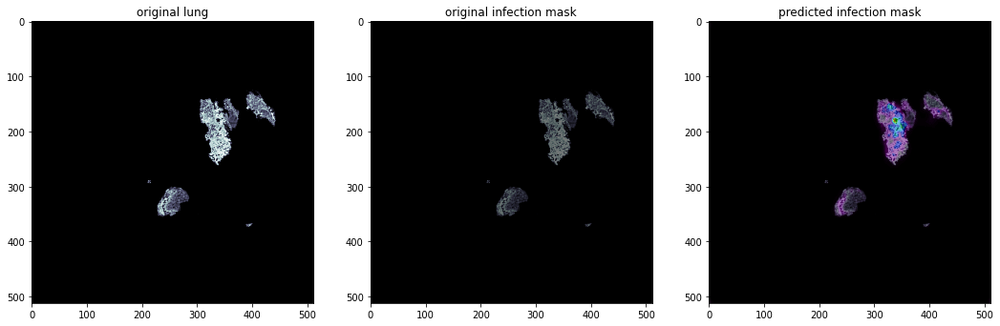

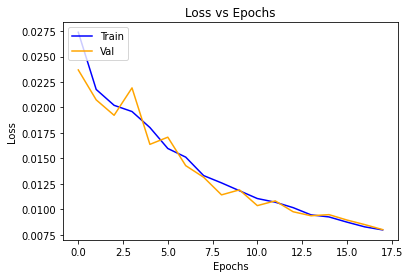

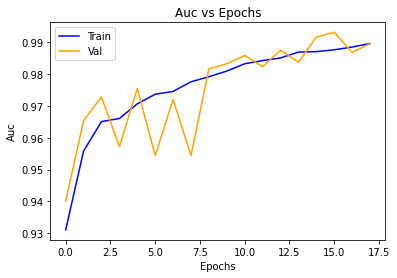

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

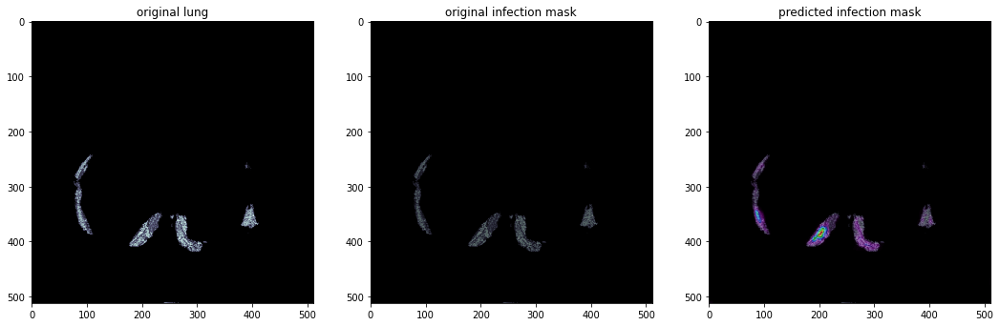

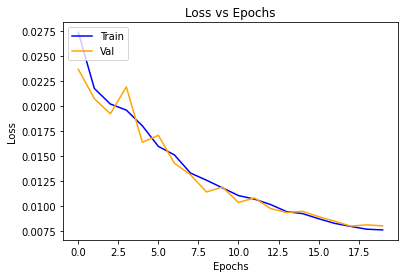

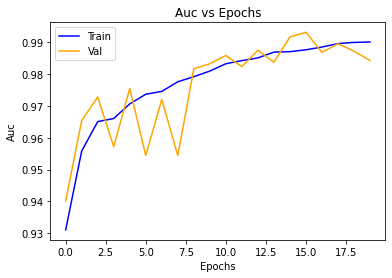

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

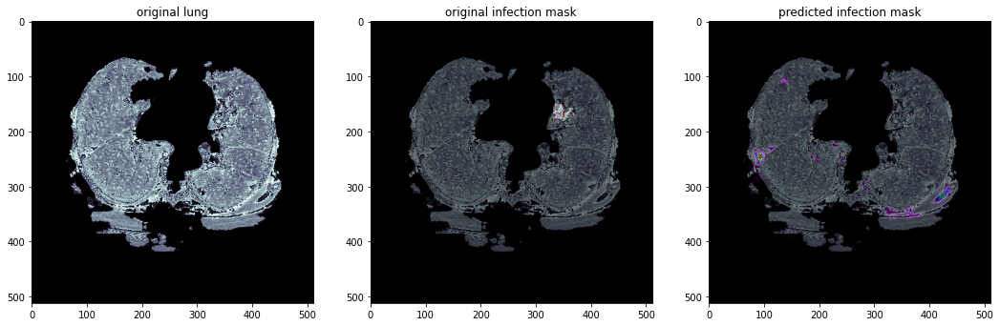

In [ ]:
unet_model = fitUnetModel(20, [metrics.AUC()])
unet_model.save('unet_model512x512.h5')

#Легкие

In [ ]:
!tar -xvf /content/drive/MyDrive/ЭэЭэЭэЭксперименты/Нейронки/MedAI/lung_dataset.tar.gz

Streaming output truncated to the last 5000 lines.
lung_dataset/lung_imgs/radiopaedia_10_85902_3_94.npy
lung_dataset/lung_imgs/coronacases_009_147.npy
lung_dataset/lung_imgs/coronacases_001_283.npy
lung_dataset/lung_imgs/coronacases_009_130.npy
lung_dataset/lung_imgs/coronacases_001_298.npy
lung_dataset/lung_imgs/coronacases_010_252.npy
lung_dataset/lung_imgs/radiopaedia_29_86491_1_2.npy
lung_dataset/lung_imgs/coronacases_001_210.npy
lung_dataset/lung_imgs/coronacases_007_245.npy
lung_dataset/lung_imgs/coronacases_002_188.npy
lung_dataset/lung_imgs/coronacases_004_188.npy
lung_dataset/lung_imgs/coronacases_004_9.npy
lung_dataset/lung_imgs/radiopaedia_36_86526_0_4.npy
lung_dataset/lung_imgs/coronacases_004_244.npy
lung_dataset/lung_imgs/coronacases_004_38.npy
lung_dataset/lung_imgs/coronacases_007_144.npy
lung_dataset/lung_imgs/radiopaedia_10_85902_3_391.npy
lung_dataset/lung_imgs/coronacases_008_130.npy
lung_dataset/lung_imgs/radiopaedia_4_85506_1_19.npy
lung_dataset/lung_imgs/coronaca

In [ ]:
metadata = pd.read_csv('/content/lung_dataset/resdf.csv')

In [ ]:
metadata.head()

,Unnamed: 0,ct_img,lung_img
0,0,lung_dataset/ct_imgs/coronacases_org_001_0.npy,lung_dataset/lung_imgs/coronacases_001_0.npy
1,1,lung_dataset/ct_imgs/coronacases_org_001_1.npy,lung_dataset/lung_imgs/coronacases_001_1.npy
2,2,lung_dataset/ct_imgs/coronacases_org_001_2.npy,lung_dataset/lung_imgs/coronacases_001_2.npy
3,3,lung_dataset/ct_imgs/coronacases_org_001_3.npy,lung_dataset/lung_imgs/coronacases_001_3.npy
4,4,lung_dataset/ct_imgs/coronacases_org_001_4.npy,lung_dataset/lung_imgs/coronacases_001_4.npy


In [ ]:
from keras.utils.data_utils import Sequence

class LungDataGen(Sequence):
    #за подробностями в https://medium.com/analytics-vidhya/write-your-own-custom-data-generator-for-tensorflow-keras-1252b64e41c3
    #лучше чем там я не расскажу тем более, что не знаю инглиш
    def __init__(self, df, X_col, y_col,
                 batch_size,
                 shuffle=True):
        
        self.df = df.copy()
        self.X_col = X_col
        self.y_col = y_col
        self.batch_size = batch_size
        self.shuffle = shuffle

        self.n = len(self.df)
    
    def on_epoch_end(self):
        if self.shuffle:
            self.df = self.df.sample(frac=1).reset_index(drop=True)
    
    def __get_input(self, path):
      arr = np.load(path)
      arr = arr[..., np.newaxis]
      return arr
    
    def __get_output(self, path):
      arr = np.load(path)
      #resarr = np.zeros((512, 512, 2))
      #arr = np.expand_dims(arr, 2)
      #resarr[:,:,0] = arr==1
      #resarr[:,:,1] = arr==0
      resarr = arr[..., np.newaxis]
      resarr[resarr>0] = 1
      return resarr
    
    def __get_data(self, batches):
      # Generates data containing batch_size samples
      ct_path_batch = batches[self.X_col['ct_path']]
      infect_path_batch = batches[self.y_col['lung_path']]
      X_batch = np.asarray([self.__get_input('/content/'+x) for x in ct_path_batch])
      y_batch = np.asarray([self.__get_output('/content/'+y) for y in infect_path_batch])
      return X_batch, y_batch
    
    def __getitem__(self, index):
      '''Роль метода __getitem__ заключается в генерации одного батча данных. 
      В данном случае одной партией данных будет пара значений (X, y), где X представляет вход, а y - выход.'''
        
      batches = self.df[index * self.batch_size:(index + 1) * self.batch_size]
      X, y = self.__get_data(batches) 
      return np.array(X)/255., y
    
    def __len__(self):
        return self.n // self.batch_size

In [ ]:
VAL_SPLIT = 0.8

In [ ]:
resdf = metadata.sample(frac=1)

traingen = LungDataGen(resdf.iloc[:int((resdf.shape[0]-1)*VAL_SPLIT), :],
                         X_col={'ct_path':'ct_img'},
                         y_col={'lung_path': 'lung_img'},
                         batch_size=8)

valgen = LungDataGen(resdf.iloc[int((resdf.shape[0]-1)*VAL_SPLIT):, :],
                        X_col={'ct_path':'ct_img'},
                        y_col={'lung_path': 'lung_img'},
                        batch_size=8)

[0]


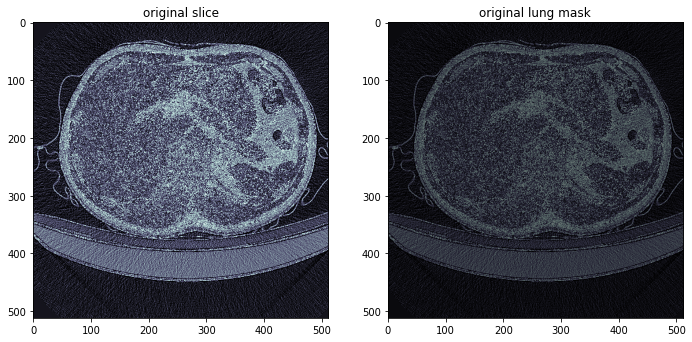

In [ ]:
lung_slice = valgen[4][0][0]
infect_slice = valgen[4][1][0]
fig = plt.figure(figsize = (18,15))

plt.subplot(1,3,1)
#plt.imshow(lung_test[slicenum][...,0], cmap = 'bone')
plt.imshow(lung_slice[...,0], cmap = 'bone')
plt.title('original slice')

plt.subplot(1,3,2)
plt.imshow(lung_slice[...,0], cmap = 'bone')
plt.imshow(infect_slice[...,0],alpha = 0.5, cmap = "nipy_spectral")
plt.title('original lung mask')
print(np.unique(infect_slice))

In [ ]:
img_size = 512

In [ ]:
from tensorflow.keras.models import *
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *
from keras import metrics

def build_lung_model(input_layer, start_neurons):
    c1 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (input_layer)
    c1 = Dropout(0.1) (c1)
    c1 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c1)
    p1 = MaxPooling2D((2, 2)) (c1)

    c2 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p1)
    c2 = Dropout(0.1) (c2)
    c2 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c2)
    p2 = MaxPooling2D((2, 2)) (c2)

    c3 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p2)
    c3 = Dropout(0.2) (c3)
    c3 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c3)
    p3 = MaxPooling2D((2, 2)) (c3)

    c4 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p3)
    c4 = Dropout(0.2) (c4)
    c4 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c4)
    p4 = MaxPooling2D(pool_size=(2, 2)) (c4)

    c5 = Conv2D(256, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p4)
    c5 = Dropout(0.3) (c5)
    c5 = Conv2D(256, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c5)

    u6 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same') (c5)
    u6 = concatenate([u6, c4])
    c6 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u6)
    c6 = Dropout(0.2) (c6)
    c6 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c6)

    u7 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same') (c6)
    u7 = concatenate([u7, c3])
    c7 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u7)
    c7 = Dropout(0.2) (c7)
    c7 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c7)

    u8 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same') (c7)
    u8 = concatenate([u8, c2])
    c8 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u8)
    c8 = Dropout(0.1) (c8)
    c8 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c8)

    u9 = Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same') (c8)
    u9 = concatenate([u9, c1], axis=3)
    c9 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u9)
    c9 = Dropout(0.1) (c9)
    c9 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c9)

    output_layer = Conv2D(1, (1, 1), activation='sigmoid') (c9)
    
    return output_layer



In [ ]:
from IPython import display

def fitUnetModel(epochs, metrics):
  input_lung_layer = Input((img_size, img_size, 1))
  output_lung_layer = build_lung_model(input_lung_layer, 16)
  model = Model(input_lung_layer, output_lung_layer)
  slicenum = 10
  model.compile(loss="binary_crossentropy", optimizer="adam", metrics=metrics)
  hist = {}
  for i in range(epochs//2):
    print(i)
    history = model.fit_generator(generator=traingen, epochs=2, validation_data=valgen, validation_freq=1)
    if len(hist.keys())==0:
      hist = history.history
    else:
      for key in history.history.keys():
        hist[key].extend(history.history[key])
    print(hist)
    for metr in hist.keys():
      fig = plt.figure()
      if not metr.startswith('val_'):
        print(metr)
        plt.plot(hist[metr], color='blue')
        plt.plot(hist['val_'+metr], color='orange')
        plt.title(metr.capitalize()+' vs Epochs')
        plt.xlabel('Epochs')
        plt.ylabel(metr.capitalize())
        plt.legend(['Train', 'Val'], loc = 'upper left')
        display.display(plt.gcf())
      del fig
    print(valgen[slicenum][0].shape)
    lung_slice = valgen[slicenum][0][0]
    infect_slice = valgen[slicenum][1][0]
    predicted = model.predict(valgen[slicenum][0])
    fig = plt.figure(figsize = (18,15))

    plt.subplot(1,3,1)
    #plt.imshow(lung_test[slicenum][...,0], cmap = 'bone')
    plt.imshow(lung_slice[...,0], cmap = 'bone')
    plt.title('original slice')

    plt.subplot(1,3,2)
    plt.imshow(lung_slice[...,0], cmap = 'bone')
    plt.imshow(infect_slice[...,0],alpha = 0.5, cmap = "nipy_spectral")
    plt.title('original lung mask')

    plt.subplot(1,3,3)
    plt.imshow(lung_slice[...,0], cmap = 'bone')
    plt.imshow(predicted[0,:,:,0],alpha = 0.5,cmap = "nipy_spectral")
    plt.title('predicted lung mask')
    display.display(plt.gcf())
    del fig
    model.save('lung_unet_model512x512.h5')
  return model

0
Epoch 1/2


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  if sys.path[0] == '':


351/351 [==============================] - 125s 350ms/step - loss: 0.2172 - auc_2: 0.8912 - val_loss: 0.1557 - val_auc_2: 0.9497
Epoch 2/2
351/351 [==============================] - 123s 350ms/step - loss: 0.0938 - auc_2: 0.9830 - val_loss: 0.0708 - val_auc_2: 0.9894
{'loss': [0.2171705663204193, 0.09381937235593796], 'auc_2': [0.8912014961242676, 0.9830357432365417], 'val_loss': [0.1556941121816635, 0.07080546021461487], 'val_auc_2': [0.9497272968292236, 0.9894024729728699]}
loss


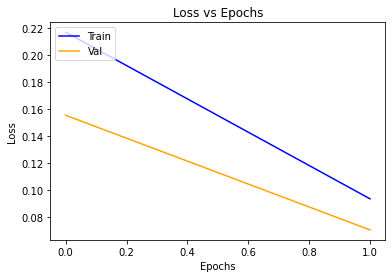

auc_2


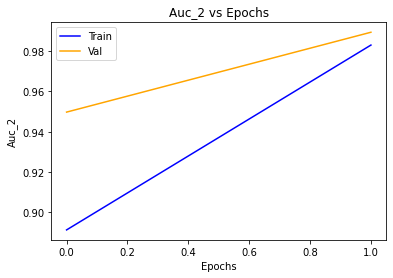

(8, 512, 512, 1)


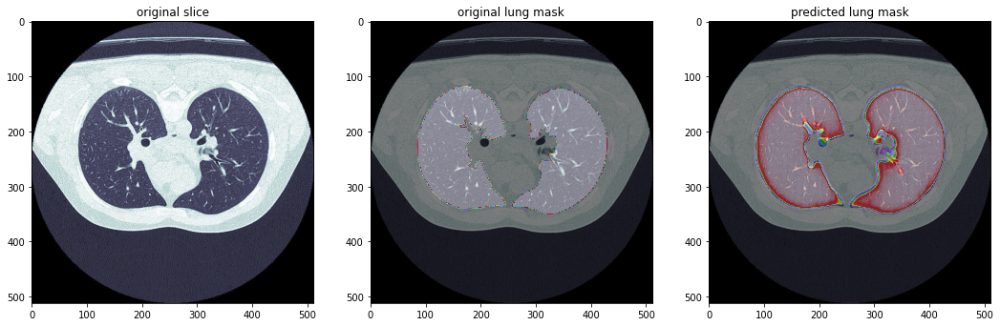

1
Epoch 1/2
351/351 [==============================] - 123s 352ms/step - loss: 0.0618 - auc_2: 0.9924 - val_loss: 0.0606 - val_auc_2: 0.9926
Epoch 2/2
351/351 [==============================] - 123s 352ms/step - loss: 0.0478 - auc_2: 0.9952 - val_loss: 0.0351 - val_auc_2: 0.9967
{'loss': [0.2171705663204193, 0.09381937235593796, 0.06178022176027298, 0.047815725207328796], 'auc_2': [0.8912014961242676, 0.9830357432365417, 0.992397665977478, 0.9952477812767029], 'val_loss': [0.1556941121816635, 0.07080546021461487, 0.06055250018835068, 0.035063449293375015], 'val_auc_2': [0.9497272968292236, 0.9894024729728699, 0.9925571084022522, 0.9966755509376526]}
loss


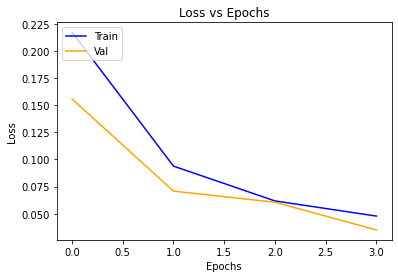

auc_2


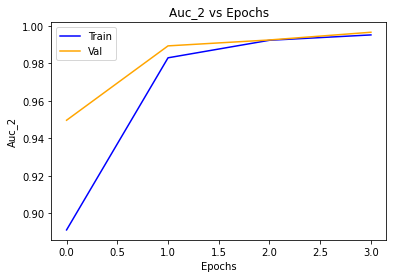

(8, 512, 512, 1)


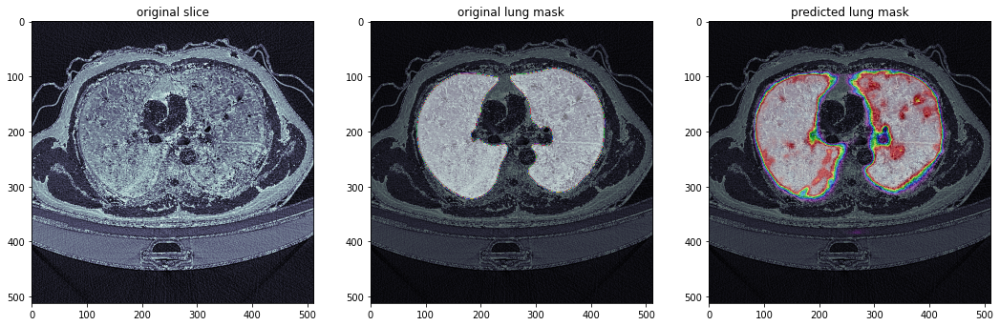

2
Epoch 1/2
351/351 [==============================] - 124s 354ms/step - loss: 0.0353 - auc_2: 0.9973 - val_loss: 0.0357 - val_auc_2: 0.9972
Epoch 2/2
351/351 [==============================] - 124s 353ms/step - loss: 0.0311 - auc_2: 0.9979 - val_loss: 0.0276 - val_auc_2: 0.9982
{'loss': [0.2171705663204193, 0.09381937235593796, 0.06178022176027298, 0.047815725207328796, 0.03534478694200516, 0.031080417335033417], 'auc_2': [0.8912014961242676, 0.9830357432365417, 0.992397665977478, 0.9952477812767029, 0.9972923994064331, 0.9978654384613037], 'val_loss': [0.1556941121816635, 0.07080546021461487, 0.06055250018835068, 0.035063449293375015, 0.03572803735733032, 0.027596790343523026], 'val_auc_2': [0.9497272968292236, 0.9894024729728699, 0.9925571084022522, 0.9966755509376526, 0.9971820712089539, 0.9982480406761169]}
loss


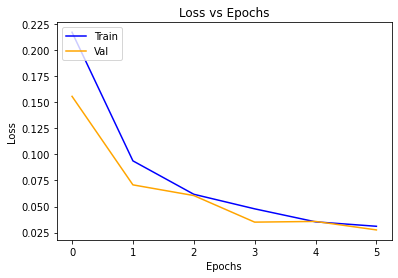

auc_2


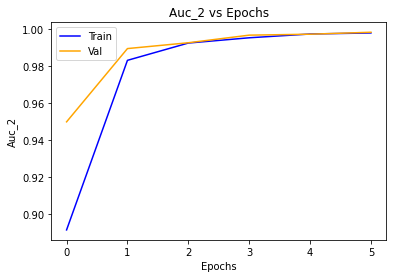

(8, 512, 512, 1)


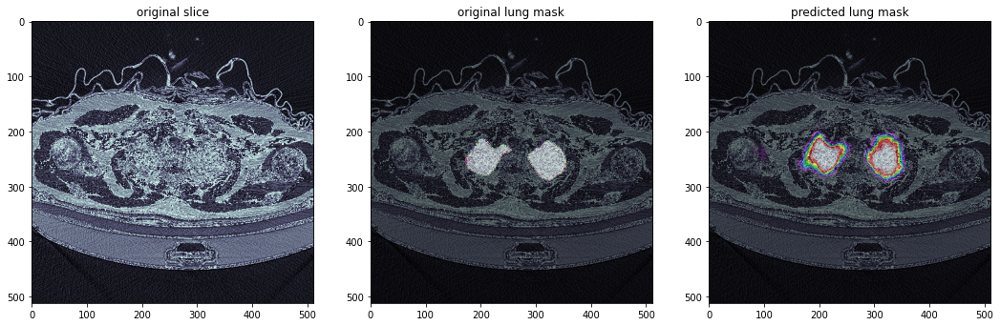

3
Epoch 1/2
351/351 [==============================] - 124s 353ms/step - loss: 0.0257 - auc_2: 0.9985 - val_loss: 0.0299 - val_auc_2: 0.9981
Epoch 2/2
351/351 [==============================] - 124s 353ms/step - loss: 0.0231 - auc_2: 0.9987 - val_loss: 0.0319 - val_auc_2: 0.9979
{'loss': [0.2171705663204193, 0.09381937235593796, 0.06178022176027298, 0.047815725207328796, 0.03534478694200516, 0.031080417335033417, 0.025707125663757324, 0.023146014660596848], 'auc_2': [0.8912014961242676, 0.9830357432365417, 0.992397665977478, 0.9952477812767029, 0.9972923994064331, 0.9978654384613037, 0.998482346534729, 0.9987179636955261], 'val_loss': [0.1556941121816635, 0.07080546021461487, 0.06055250018835068, 0.035063449293375015, 0.03572803735733032, 0.027596790343523026, 0.029870862141251564, 0.031908515840768814], 'val_auc_2': [0.9497272968292236, 0.9894024729728699, 0.9925571084022522, 0.9966755509376526, 0.9971820712089539, 0.9982480406761169, 0.9981252551078796, 0.997909426689148]}
loss


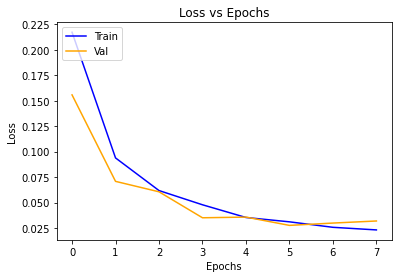

auc_2


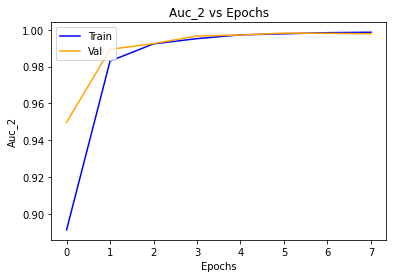

(8, 512, 512, 1)


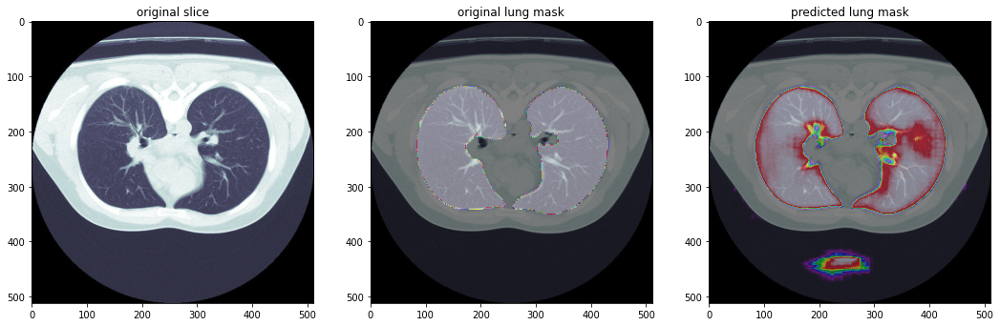

4
Epoch 1/2
351/351 [==============================] - 124s 354ms/step - loss: 0.0303 - auc_2: 0.9977 - val_loss: 0.0213 - val_auc_2: 0.9986
Epoch 2/2
351/351 [==============================] - 124s 353ms/step - loss: 0.0199 - auc_2: 0.9990 - val_loss: 0.0192 - val_auc_2: 0.9992
{'loss': [0.2171705663204193, 0.09381937235593796, 0.06178022176027298, 0.047815725207328796, 0.03534478694200516, 0.031080417335033417, 0.025707125663757324, 0.023146014660596848, 0.030306974425911903, 0.0199066624045372], 'auc_2': [0.8912014961242676, 0.9830357432365417, 0.992397665977478, 0.9952477812767029, 0.9972923994064331, 0.9978654384613037, 0.998482346534729, 0.9987179636955261, 0.9976503252983093, 0.999038577079773], 'val_loss': [0.1556941121816635, 0.07080546021461487, 0.06055250018835068, 0.035063449293375015, 0.03572803735733032, 0.027596790343523026, 0.029870862141251564, 0.031908515840768814, 0.021328462287783623, 0.019175924360752106], 'val_auc_2': [0.9497272968292236, 0.9894024729728699, 0.992

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


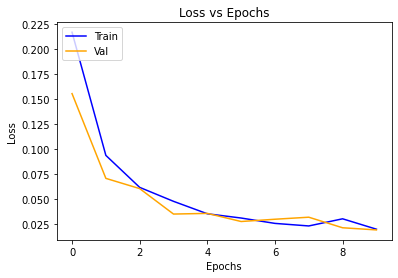

auc_2


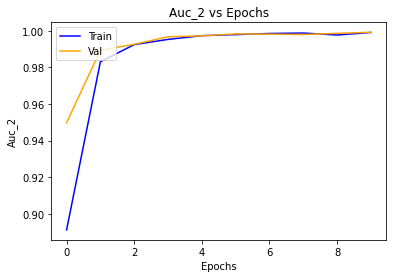

(8, 512, 512, 1)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


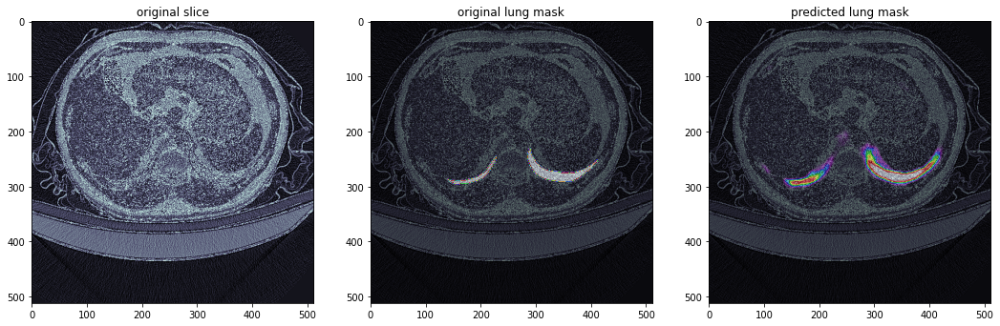

5
Epoch 1/2
351/351 [==============================] - 124s 353ms/step - loss: 0.0180 - auc_2: 0.9992 - val_loss: 0.0173 - val_auc_2: 0.9991
Epoch 2/2
351/351 [==============================] - 124s 353ms/step - loss: 0.0178 - auc_2: 0.9992 - val_loss: 0.0204 - val_auc_2: 0.9983
{'loss': [0.2171705663204193, 0.09381937235593796, 0.06178022176027298, 0.047815725207328796, 0.03534478694200516, 0.031080417335033417, 0.025707125663757324, 0.023146014660596848, 0.030306974425911903, 0.0199066624045372, 0.018019292503595352, 0.01778145506978035], 'auc_2': [0.8912014961242676, 0.9830357432365417, 0.992397665977478, 0.9952477812767029, 0.9972923994064331, 0.9978654384613037, 0.998482346534729, 0.9987179636955261, 0.9976503252983093, 0.999038577079773, 0.9991759657859802, 0.999190628528595], 'val_loss': [0.1556941121816635, 0.07080546021461487, 0.06055250018835068, 0.035063449293375015, 0.03572803735733032, 0.027596790343523026, 0.029870862141251564, 0.031908515840768814, 0.021328462287783623, 

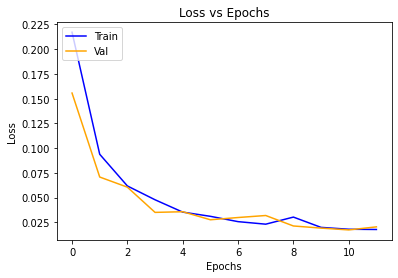

auc_2


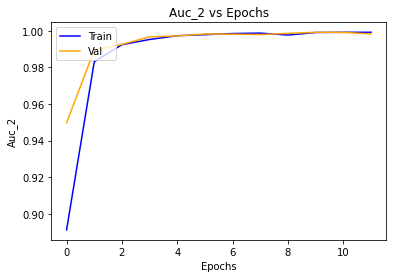

(8, 512, 512, 1)


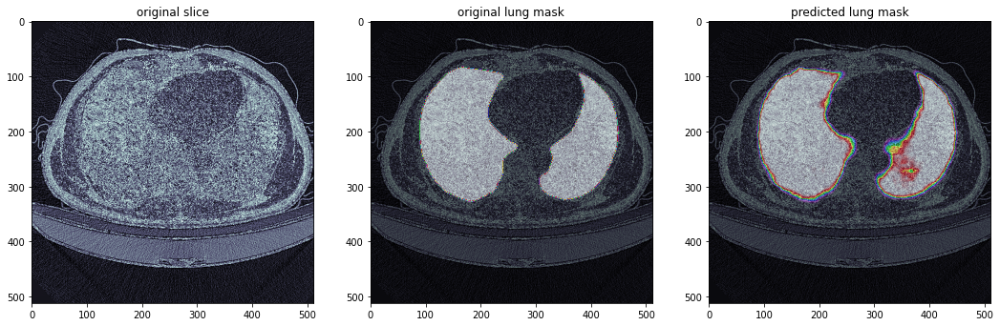

6
Epoch 1/2
351/351 [==============================] - 124s 353ms/step - loss: 0.0162 - auc_2: 0.9993 - val_loss: 0.0200 - val_auc_2: 0.9992
Epoch 2/2
351/351 [==============================] - 124s 353ms/step - loss: 0.0158 - auc_2: 0.9994 - val_loss: 0.0154 - val_auc_2: 0.9992
{'loss': [0.2171705663204193, 0.09381937235593796, 0.06178022176027298, 0.047815725207328796, 0.03534478694200516, 0.031080417335033417, 0.025707125663757324, 0.023146014660596848, 0.030306974425911903, 0.0199066624045372, 0.018019292503595352, 0.01778145506978035, 0.01622648350894451, 0.015757685527205467], 'auc_2': [0.8912014961242676, 0.9830357432365417, 0.992397665977478, 0.9952477812767029, 0.9972923994064331, 0.9978654384613037, 0.998482346534729, 0.9987179636955261, 0.9976503252983093, 0.999038577079773, 0.9991759657859802, 0.999190628528595, 0.9993369579315186, 0.9993665814399719], 'val_loss': [0.1556941121816635, 0.07080546021461487, 0.06055250018835068, 0.035063449293375015, 0.03572803735733032, 0.027

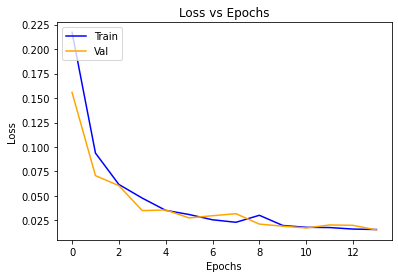

auc_2


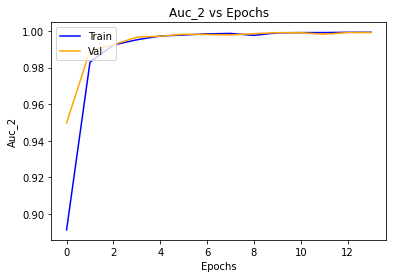

(8, 512, 512, 1)


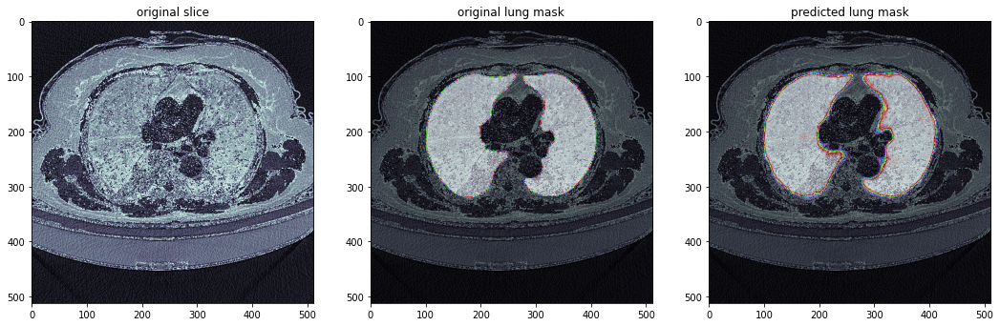

7
Epoch 1/2
351/351 [==============================] - 124s 354ms/step - loss: 0.0156 - auc_2: 0.9994 - val_loss: 0.0171 - val_auc_2: 0.9989
Epoch 2/2
351/351 [==============================] - 124s 353ms/step - loss: 0.0270 - auc_2: 0.9981 - val_loss: 0.0173 - val_auc_2: 0.9993
{'loss': [0.2171705663204193, 0.09381937235593796, 0.06178022176027298, 0.047815725207328796, 0.03534478694200516, 0.031080417335033417, 0.025707125663757324, 0.023146014660596848, 0.030306974425911903, 0.0199066624045372, 0.018019292503595352, 0.01778145506978035, 0.01622648350894451, 0.015757685527205467, 0.01563030295073986, 0.027007345110177994], 'auc_2': [0.8912014961242676, 0.9830357432365417, 0.992397665977478, 0.9952477812767029, 0.9972923994064331, 0.9978654384613037, 0.998482346534729, 0.9987179636955261, 0.9976503252983093, 0.999038577079773, 0.9991759657859802, 0.999190628528595, 0.9993369579315186, 0.9993665814399719, 0.9993573427200317, 0.9981222152709961], 'val_loss': [0.1556941121816635, 0.07080

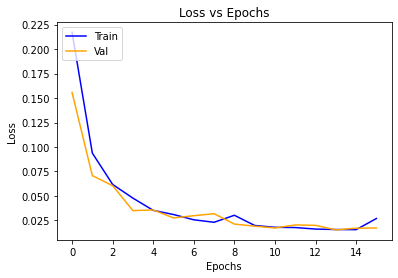

auc_2


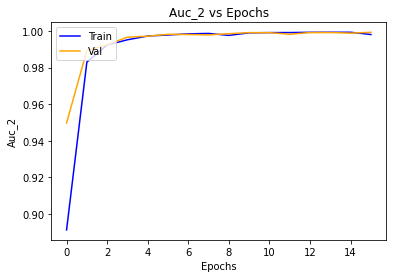

(8, 512, 512, 1)


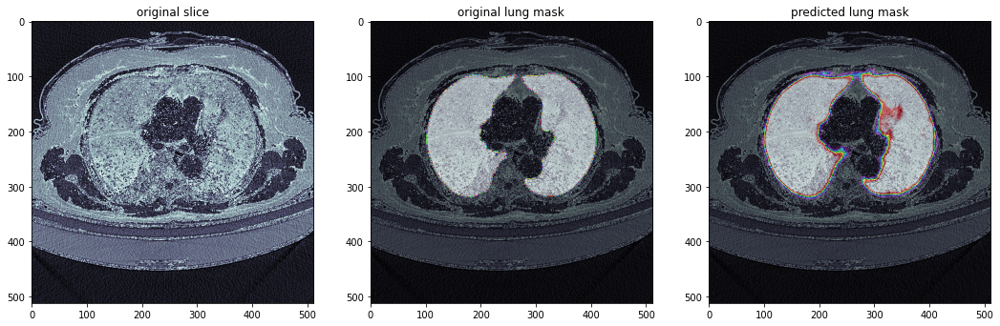

8
Epoch 1/2
351/351 [==============================] - 124s 353ms/step - loss: 0.0171 - auc_2: 0.9993 - val_loss: 0.0150 - val_auc_2: 0.9994
Epoch 2/2
351/351 [==============================] - 124s 352ms/step - loss: 0.0146 - auc_2: 0.9995 - val_loss: 0.0127 - val_auc_2: 0.9995
{'loss': [0.2171705663204193, 0.09381937235593796, 0.06178022176027298, 0.047815725207328796, 0.03534478694200516, 0.031080417335033417, 0.025707125663757324, 0.023146014660596848, 0.030306974425911903, 0.0199066624045372, 0.018019292503595352, 0.01778145506978035, 0.01622648350894451, 0.015757685527205467, 0.01563030295073986, 0.027007345110177994, 0.017059635370969772, 0.014595072716474533], 'auc_2': [0.8912014961242676, 0.9830357432365417, 0.992397665977478, 0.9952477812767029, 0.9972923994064331, 0.9978654384613037, 0.998482346534729, 0.9987179636955261, 0.9976503252983093, 0.999038577079773, 0.9991759657859802, 0.999190628528595, 0.9993369579315186, 0.9993665814399719, 0.9993573427200317, 0.998122215270996

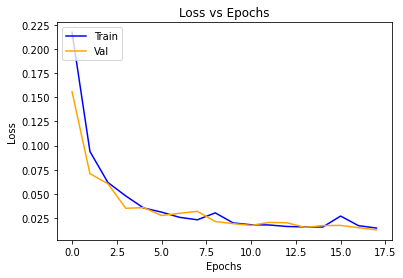

auc_2


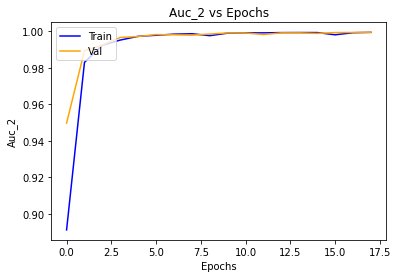

(8, 512, 512, 1)


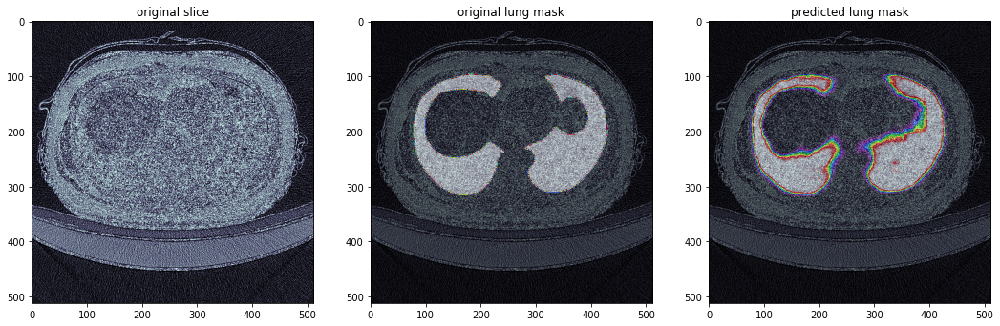

9
Epoch 1/2
351/351 [==============================] - 123s 352ms/step - loss: 0.0132 - auc_2: 0.9995 - val_loss: 0.0125 - val_auc_2: 0.9996
Epoch 2/2
351/351 [==============================] - 123s 352ms/step - loss: 0.0134 - auc_2: 0.9995 - val_loss: 0.0124 - val_auc_2: 0.9995
{'loss': [0.2171705663204193, 0.09381937235593796, 0.06178022176027298, 0.047815725207328796, 0.03534478694200516, 0.031080417335033417, 0.025707125663757324, 0.023146014660596848, 0.030306974425911903, 0.0199066624045372, 0.018019292503595352, 0.01778145506978035, 0.01622648350894451, 0.015757685527205467, 0.01563030295073986, 0.027007345110177994, 0.017059635370969772, 0.014595072716474533, 0.013207243755459785, 0.013353623449802399], 'auc_2': [0.8912014961242676, 0.9830357432365417, 0.992397665977478, 0.9952477812767029, 0.9972923994064331, 0.9978654384613037, 0.998482346534729, 0.9987179636955261, 0.9976503252983093, 0.999038577079773, 0.9991759657859802, 0.999190628528595, 0.9993369579315186, 0.99936658143

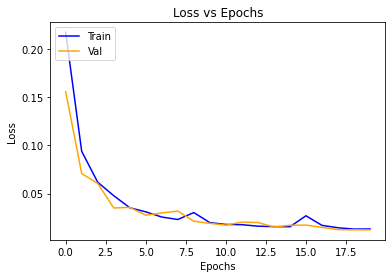

auc_2


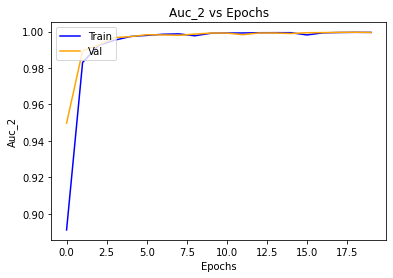

(8, 512, 512, 1)


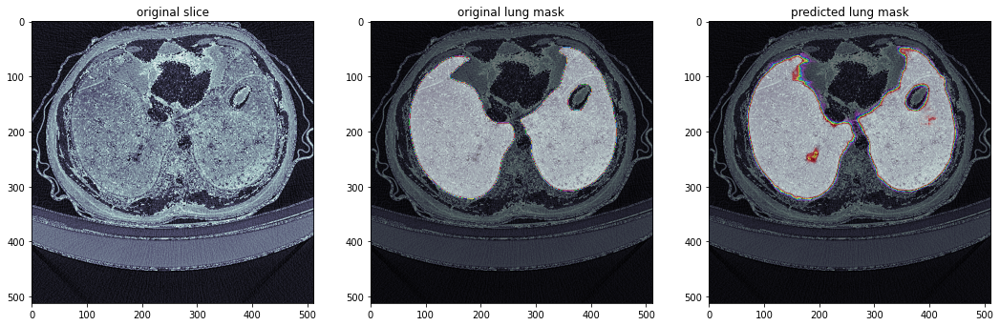

10
Epoch 1/2
351/351 [==============================] - 124s 352ms/step - loss: 0.0168 - auc_2: 0.9991 - val_loss: 0.0144 - val_auc_2: 0.9995
Epoch 2/2
351/351 [==============================] - 124s 352ms/step - loss: 0.0132 - auc_2: 0.9995 - val_loss: 0.0124 - val_auc_2: 0.9995
{'loss': [0.2171705663204193, 0.09381937235593796, 0.06178022176027298, 0.047815725207328796, 0.03534478694200516, 0.031080417335033417, 0.025707125663757324, 0.023146014660596848, 0.030306974425911903, 0.0199066624045372, 0.018019292503595352, 0.01778145506978035, 0.01622648350894451, 0.015757685527205467, 0.01563030295073986, 0.027007345110177994, 0.017059635370969772, 0.014595072716474533, 0.013207243755459785, 0.013353623449802399, 0.016823992133140564, 0.013219095766544342], 'auc_2': [0.8912014961242676, 0.9830357432365417, 0.992397665977478, 0.9952477812767029, 0.9972923994064331, 0.9978654384613037, 0.998482346534729, 0.9987179636955261, 0.9976503252983093, 0.999038577079773, 0.9991759657859802, 0.99919

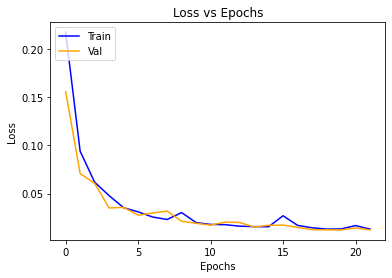

auc_2


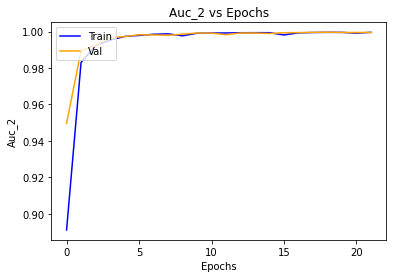

(8, 512, 512, 1)


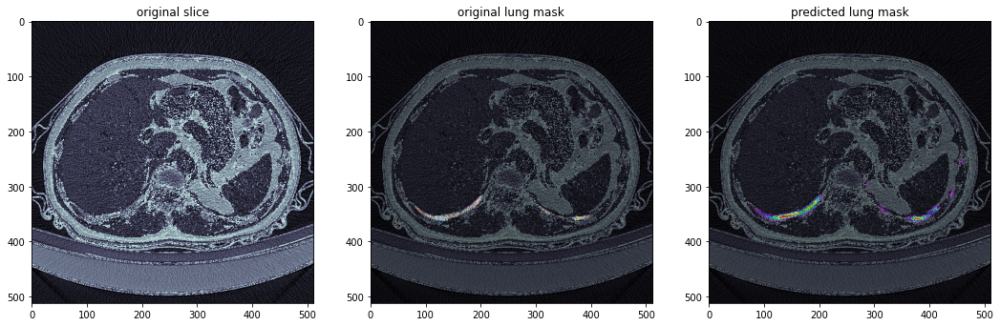

11
Epoch 1/2
351/351 [==============================] - 123s 352ms/step - loss: 0.0118 - auc_2: 0.9996 - val_loss: 0.0120 - val_auc_2: 0.9994
Epoch 2/2
351/351 [==============================] - 123s 352ms/step - loss: 0.0114 - auc_2: 0.9997 - val_loss: 0.0117 - val_auc_2: 0.9993
{'loss': [0.2171705663204193, 0.09381937235593796, 0.06178022176027298, 0.047815725207328796, 0.03534478694200516, 0.031080417335033417, 0.025707125663757324, 0.023146014660596848, 0.030306974425911903, 0.0199066624045372, 0.018019292503595352, 0.01778145506978035, 0.01622648350894451, 0.015757685527205467, 0.01563030295073986, 0.027007345110177994, 0.017059635370969772, 0.014595072716474533, 0.013207243755459785, 0.013353623449802399, 0.016823992133140564, 0.013219095766544342, 0.011823155917227268, 0.01141443569213152], 'auc_2': [0.8912014961242676, 0.9830357432365417, 0.992397665977478, 0.9952477812767029, 0.9972923994064331, 0.9978654384613037, 0.998482346534729, 0.9987179636955261, 0.9976503252983093, 0.9

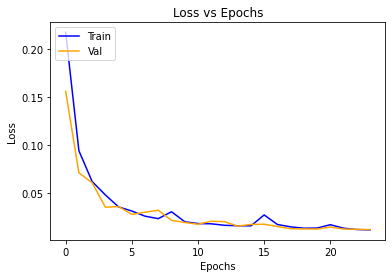

auc_2


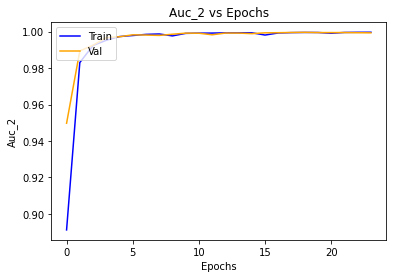

(8, 512, 512, 1)


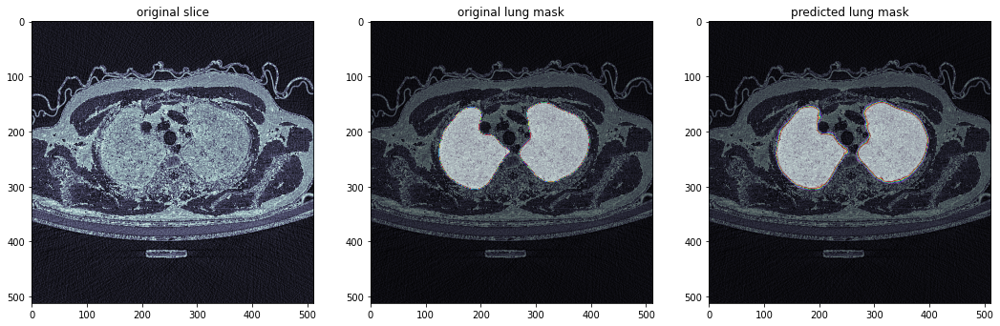

12
Epoch 1/2
351/351 [==============================] - 124s 352ms/step - loss: 0.0111 - auc_2: 0.9997 - val_loss: 0.0103 - val_auc_2: 0.9996
Epoch 2/2
351/351 [==============================] - 124s 352ms/step - loss: 0.0122 - auc_2: 0.9996 - val_loss: 0.0150 - val_auc_2: 0.9995
{'loss': [0.2171705663204193, 0.09381937235593796, 0.06178022176027298, 0.047815725207328796, 0.03534478694200516, 0.031080417335033417, 0.025707125663757324, 0.023146014660596848, 0.030306974425911903, 0.0199066624045372, 0.018019292503595352, 0.01778145506978035, 0.01622648350894451, 0.015757685527205467, 0.01563030295073986, 0.027007345110177994, 0.017059635370969772, 0.014595072716474533, 0.013207243755459785, 0.013353623449802399, 0.016823992133140564, 0.013219095766544342, 0.011823155917227268, 0.01141443569213152, 0.011098919436335564, 0.012226235121488571], 'auc_2': [0.8912014961242676, 0.9830357432365417, 0.992397665977478, 0.9952477812767029, 0.9972923994064331, 0.9978654384613037, 0.998482346534729,

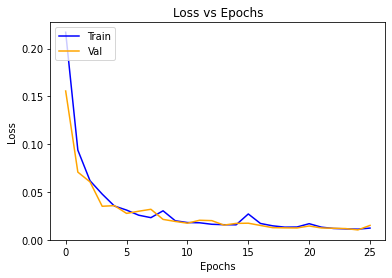

auc_2


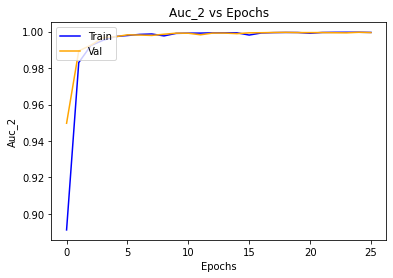

(8, 512, 512, 1)


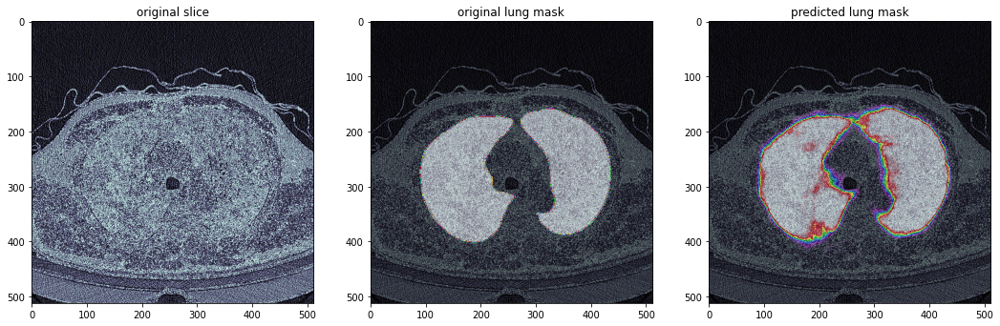

13
Epoch 1/2
351/351 [==============================] - 124s 353ms/step - loss: 0.0129 - auc_2: 0.9995 - val_loss: 0.0112 - val_auc_2: 0.9995
Epoch 2/2
351/351 [==============================] - 124s 352ms/step - loss: 0.0114 - auc_2: 0.9996 - val_loss: 0.0106 - val_auc_2: 0.9994
{'loss': [0.2171705663204193, 0.09381937235593796, 0.06178022176027298, 0.047815725207328796, 0.03534478694200516, 0.031080417335033417, 0.025707125663757324, 0.023146014660596848, 0.030306974425911903, 0.0199066624045372, 0.018019292503595352, 0.01778145506978035, 0.01622648350894451, 0.015757685527205467, 0.01563030295073986, 0.027007345110177994, 0.017059635370969772, 0.014595072716474533, 0.013207243755459785, 0.013353623449802399, 0.016823992133140564, 0.013219095766544342, 0.011823155917227268, 0.01141443569213152, 0.011098919436335564, 0.012226235121488571, 0.012906142510473728, 0.011367308907210827], 'auc_2': [0.8912014961242676, 0.9830357432365417, 0.992397665977478, 0.9952477812767029, 0.997292399406

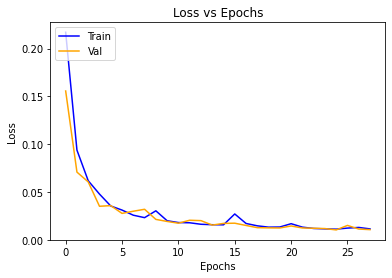

auc_2


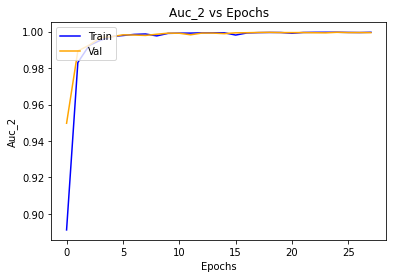

(8, 512, 512, 1)


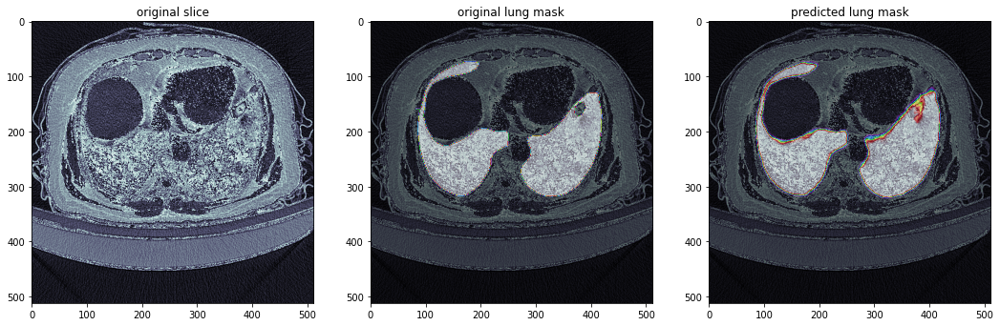

14
Epoch 1/2
351/351 [==============================] - 124s 352ms/step - loss: 0.0156 - auc_2: 0.9992 - val_loss: 0.0158 - val_auc_2: 0.9995
Epoch 2/2
351/351 [==============================] - 123s 351ms/step - loss: 0.0121 - auc_2: 0.9996 - val_loss: 0.0106 - val_auc_2: 0.9996
{'loss': [0.2171705663204193, 0.09381937235593796, 0.06178022176027298, 0.047815725207328796, 0.03534478694200516, 0.031080417335033417, 0.025707125663757324, 0.023146014660596848, 0.030306974425911903, 0.0199066624045372, 0.018019292503595352, 0.01778145506978035, 0.01622648350894451, 0.015757685527205467, 0.01563030295073986, 0.027007345110177994, 0.017059635370969772, 0.014595072716474533, 0.013207243755459785, 0.013353623449802399, 0.016823992133140564, 0.013219095766544342, 0.011823155917227268, 0.01141443569213152, 0.011098919436335564, 0.012226235121488571, 0.012906142510473728, 0.011367308907210827, 0.015551526099443436, 0.012125442735850811], 'auc_2': [0.8912014961242676, 0.9830357432365417, 0.9923976

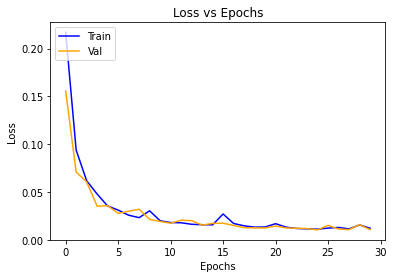

auc_2


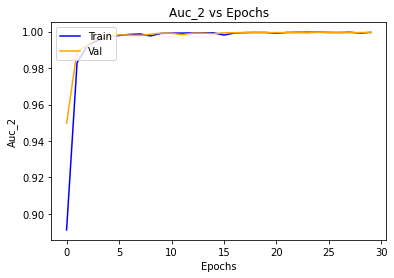

(8, 512, 512, 1)


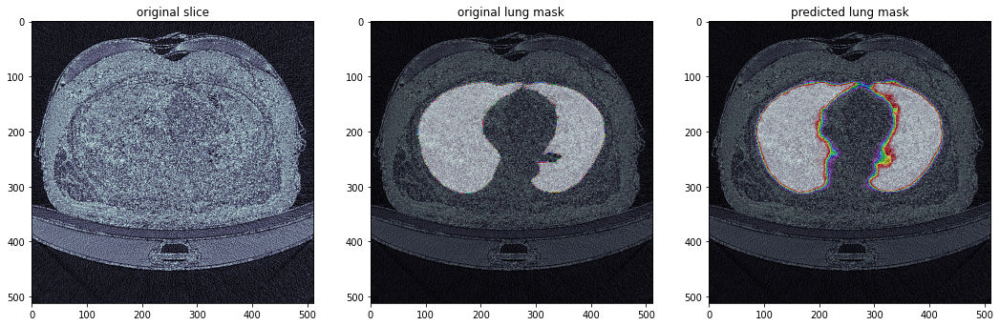

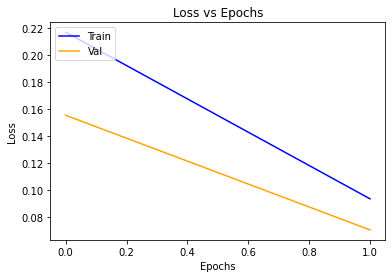

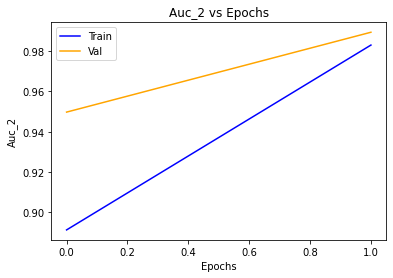

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

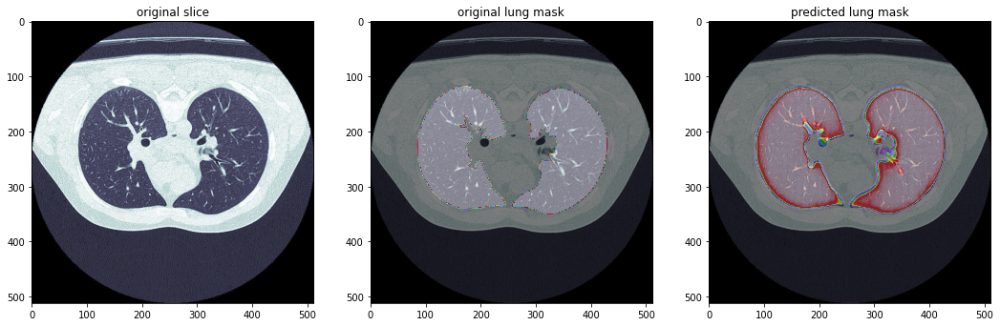

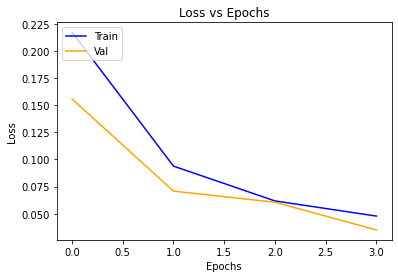

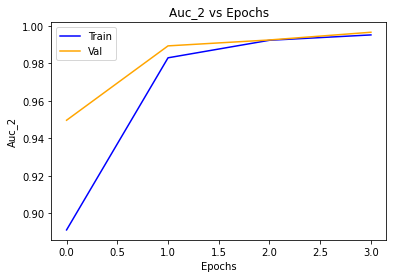

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

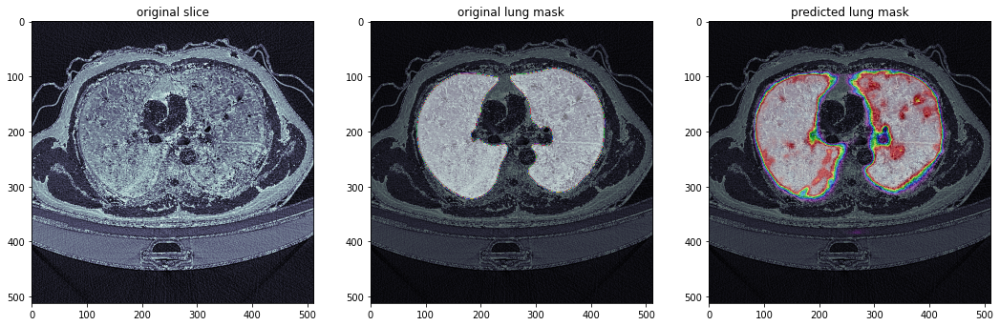

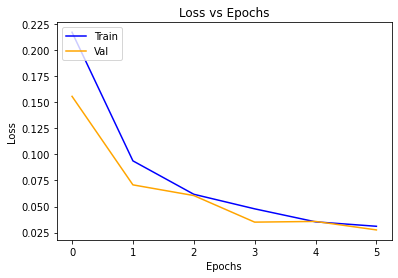

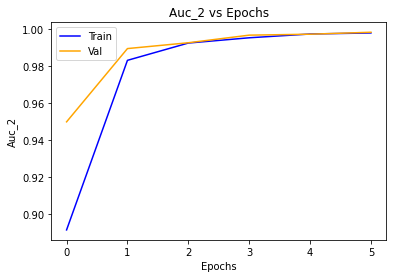

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

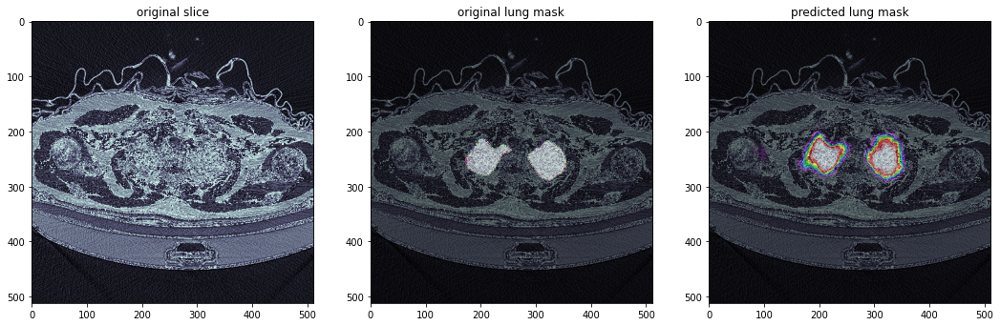

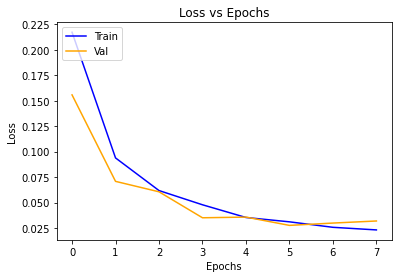

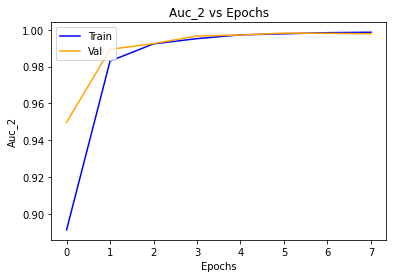

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

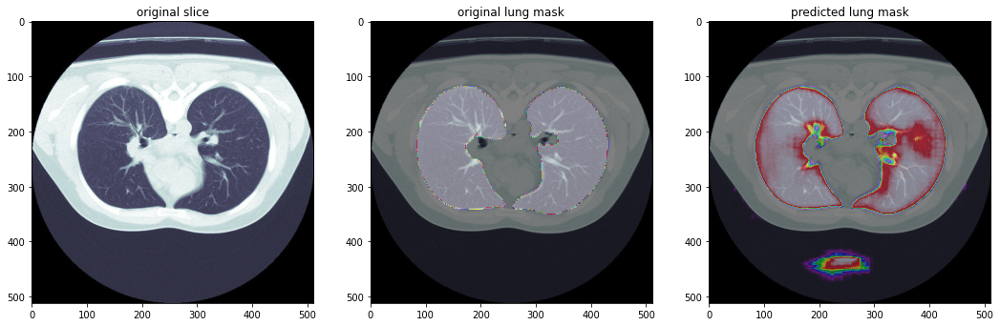

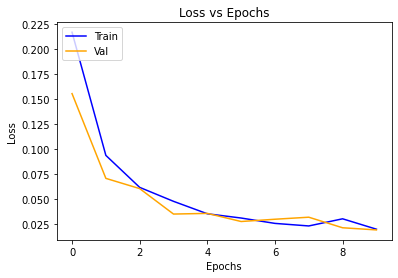

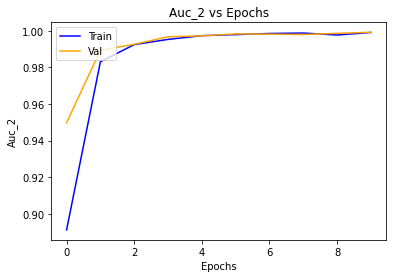

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

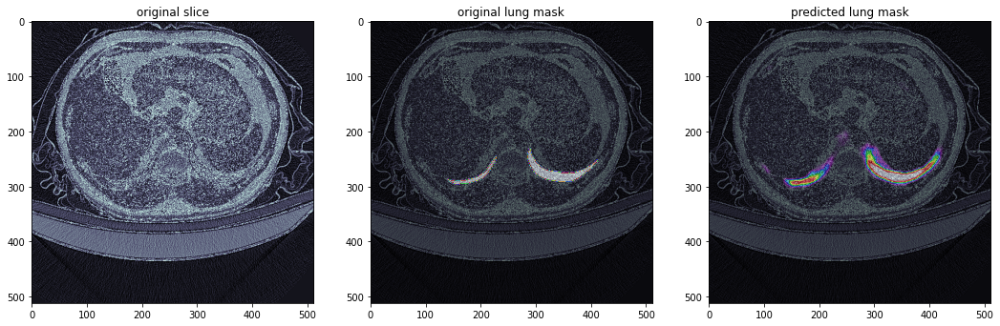

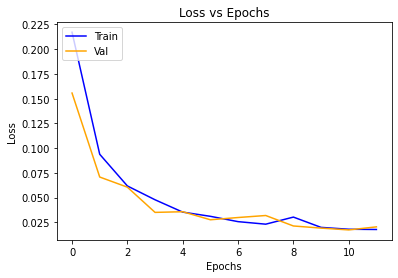

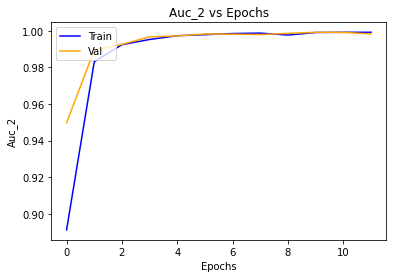

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

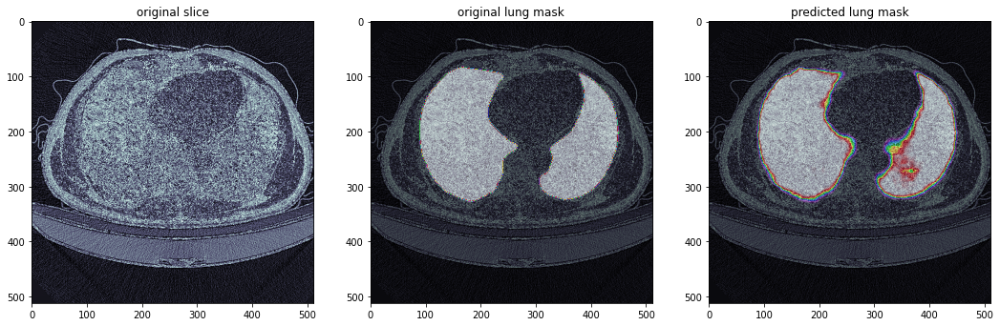

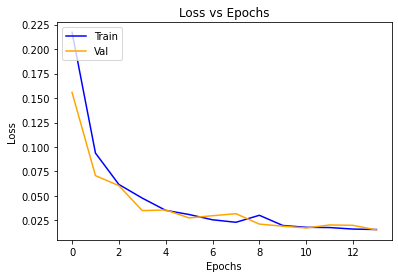

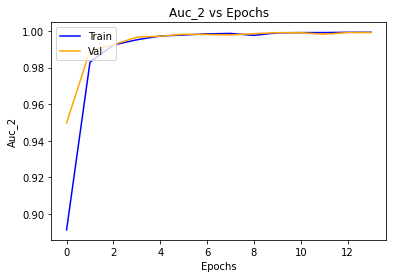

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

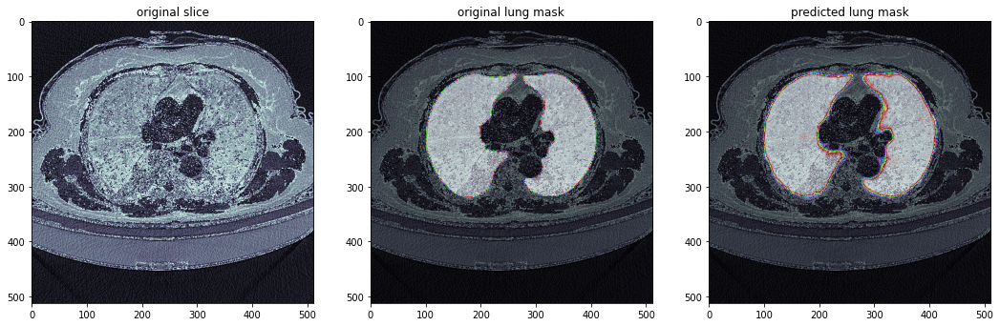

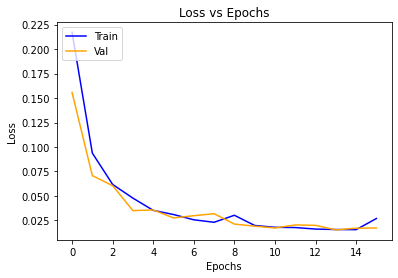

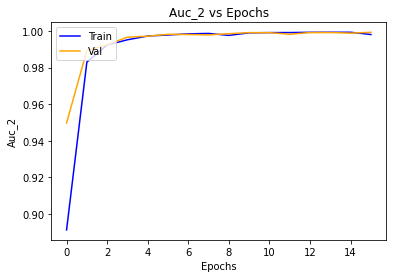

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

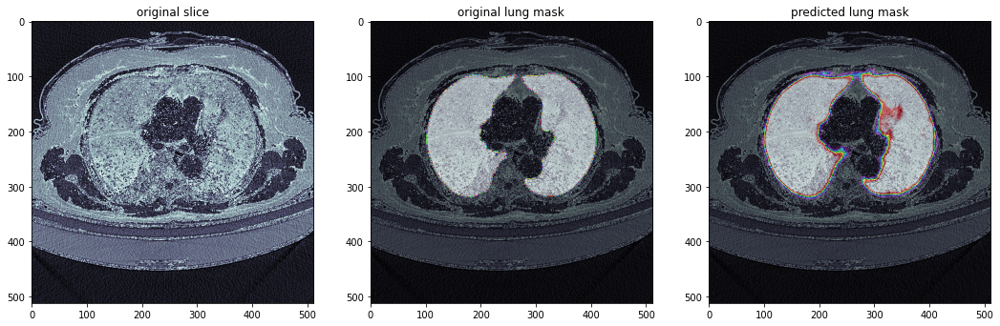

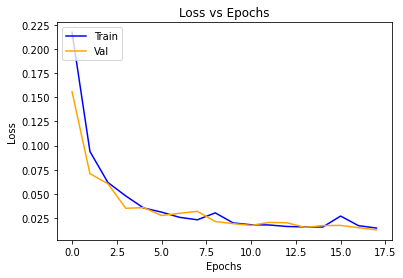

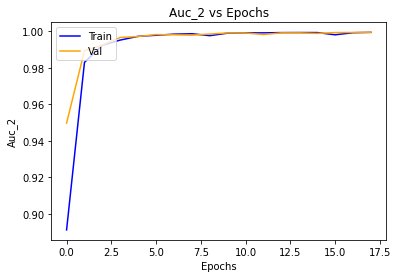

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

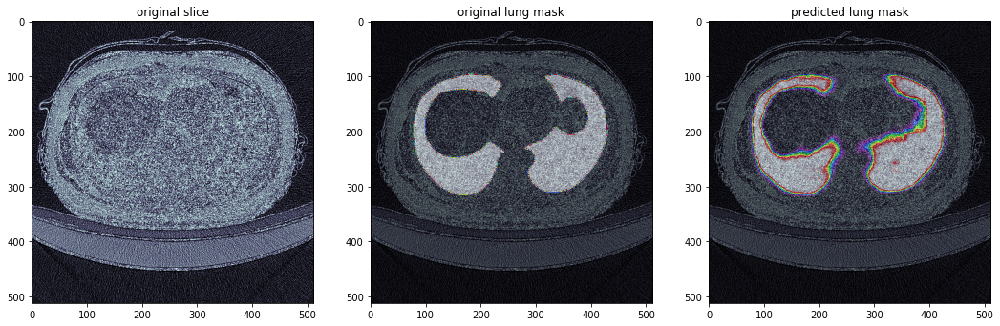

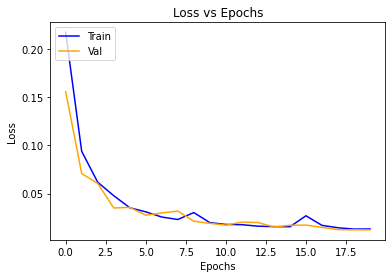

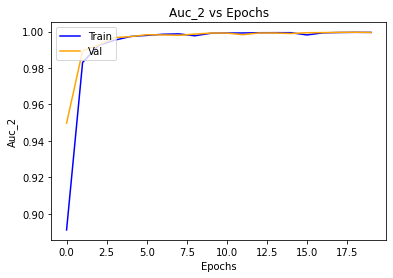

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

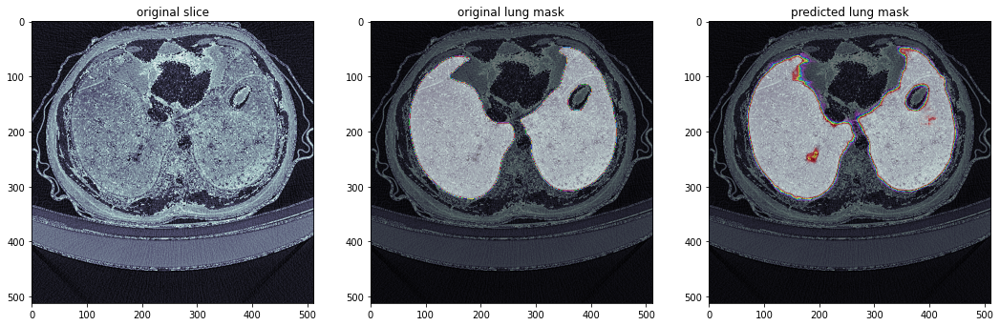

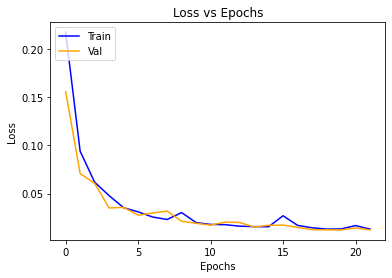

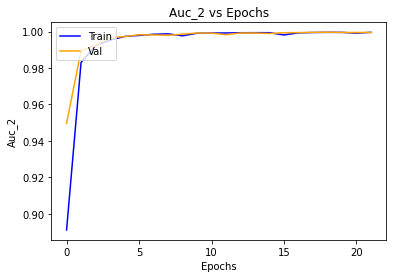

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

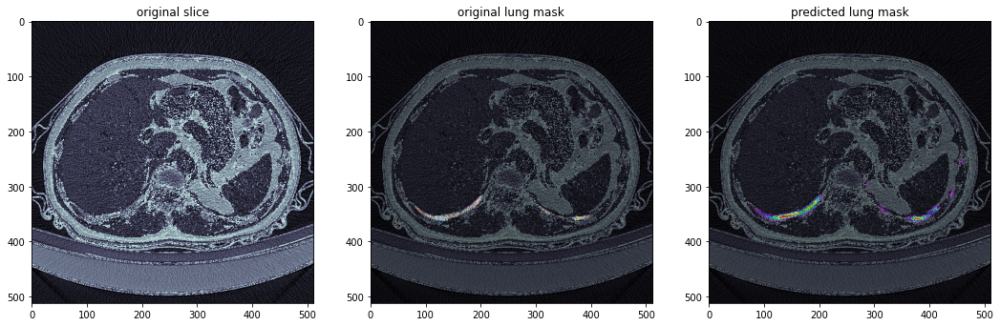

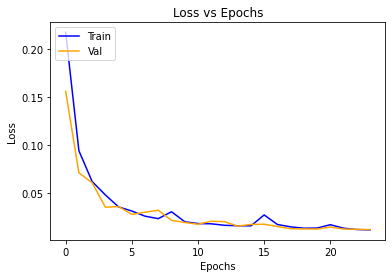

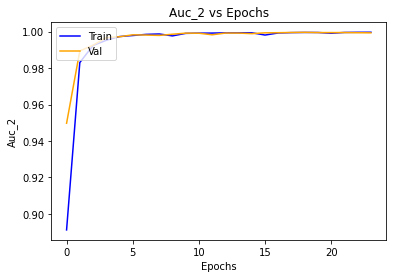

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

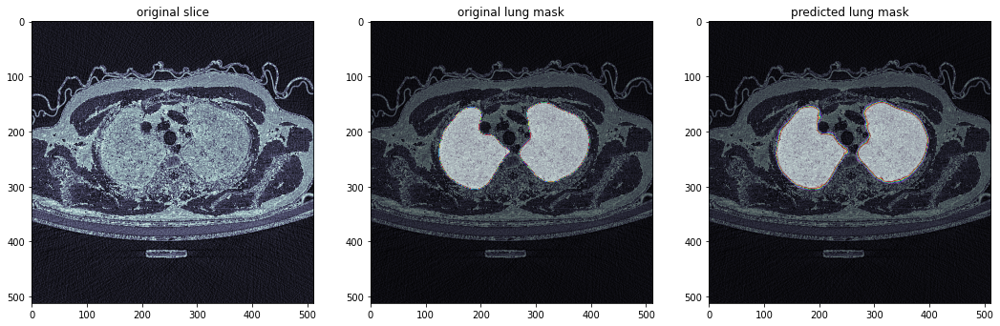

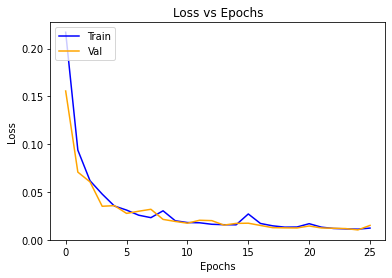

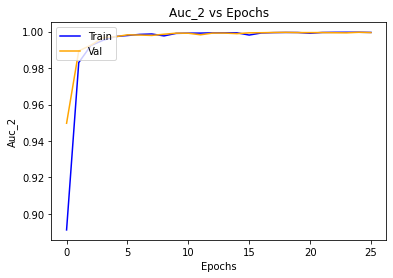

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

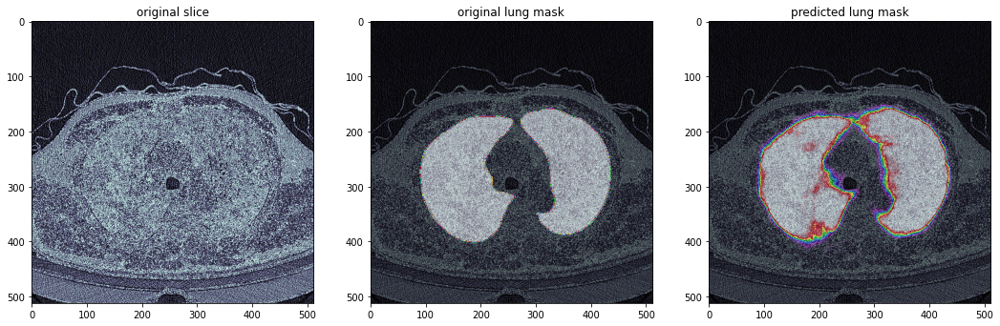

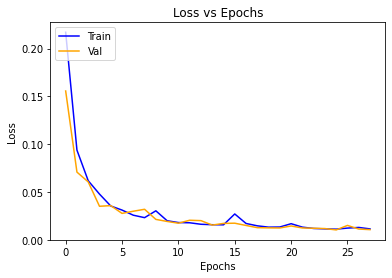

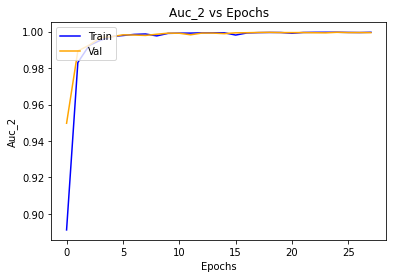

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

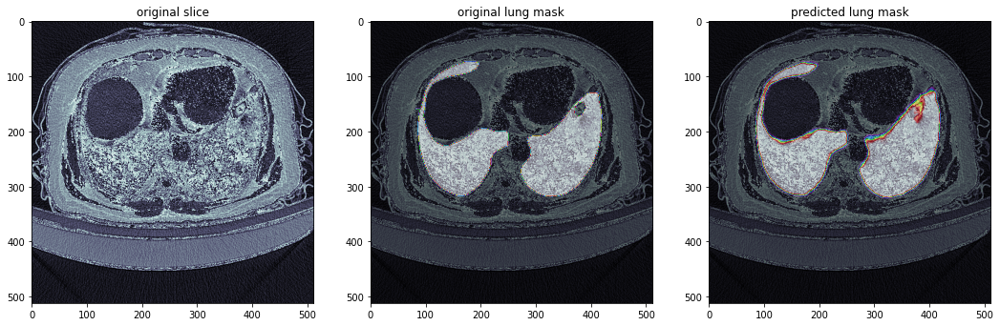

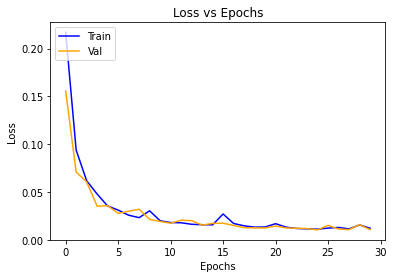

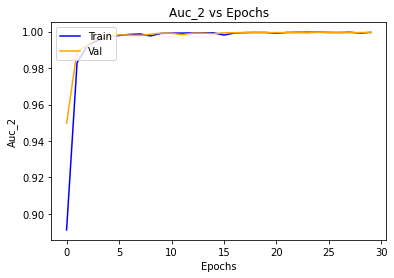

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

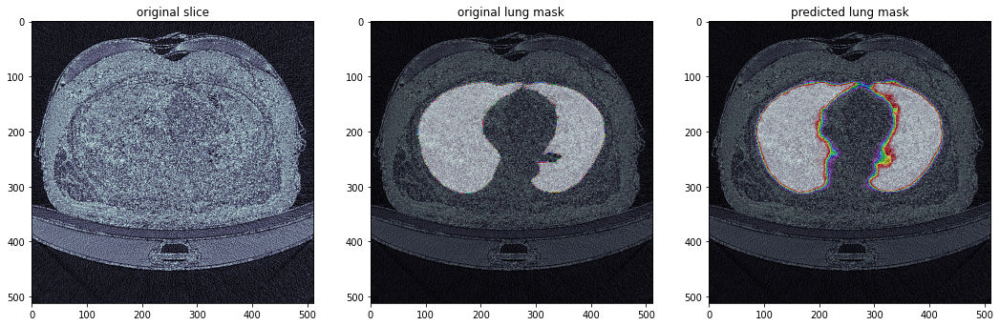

In [ ]:
lung_unet_model = fitUnetModel(30, [metrics.AUC()])
lung_unet_model.save('lung_unet_model512x512.h5')